In [11]:
img_path = 'RoofData/images/02B0200601_2015112/011.JPG'

In [158]:
import torch
import encoding
from encoding.models import get_segmentation_model
from encoding.nn import SegmentationLosses, SyncBatchNorm
from encoding.datasets import get_dataset
from torch.utils import data
import torchvision.transforms as transform
import matplotlib.pyplot as plt
import numpy as np
import os
from PIL import Image, ImageOps, ImageFilter, ImageDraw


In [9]:
model = get_segmentation_model('encnet', dataset = 'roof',
                               backbone = 'resnet50', aux = True,
                               se_loss = True, norm_layer = SyncBatchNorm,
                               base_size=520, crop_size=480)

/home/ubuntu/.pyenv/versions/roof/lib/python3.6/site-packages/urllib3-1.25.9-py3.6.egg/urllib3/connectionpool.py:986: InsecureRequestWarning: Unverified HTTPS request is being made to host 'download.pytorch.org'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning,
  0%|          | 0/100100 [00:00<?, ?KB/s]

100%|██████████| 100100/100100 [00:01<00:00, 51653.44KB/s]


In [10]:
model.eval()

EncNet(
  (pretrained): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): SyncBatchNorm(sync=False)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): SyncBatchNorm(sync=False)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): SyncBatchNorm(sync=False)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): SyncBatchNorm(sync=False)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (1): SyncBatchNorm(sync=False)
        )
      )
      (1): Bottleneck(
        (conv1): Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1

In [49]:
checkpoint_path = '/home/ubuntu/runs/roof/encnet/resnet50/default/model_best.pth.tar'

In [61]:
model.cuda()

EncNet(
  (pretrained): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): SyncBatchNorm(sync=False)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): SyncBatchNorm(sync=False)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): SyncBatchNorm(sync=False)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): SyncBatchNorm(sync=False)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (1): SyncBatchNorm(sync=False)
        )
      )
      (1): Bottleneck(
        (conv1): Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1

In [143]:
model.load_state_dict(torch.load(checkpoint_path)['state_dict'])

<All keys matched successfully>

In [94]:
testset_img = get_dataset('roof', split='val', mode ='val')

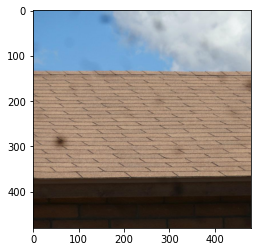

In [99]:
plt.imshow(testset_img[0][0])

In [27]:
input_transform = transform.Compose([
    transform.ToTensor(),
    transform.Normalize([.485, .456, .406], [.229, .224, .225])])

In [28]:
testset = get_dataset('roof', split='val', mode ='val',transform = input_transform)

In [30]:
valloader = data.DataLoader(testset, batch_size=1,
                                 drop_last=False, shuffle=False)

In [146]:
import pickle

In [147]:
path_to_pkl = '/home/ubuntu/.encoding/data/RoofData/cache.pkl'
with open(path_to_pkl, 'rb') as f:
    data = pickle.load(f)

02B0002701_2015095/002.JPG


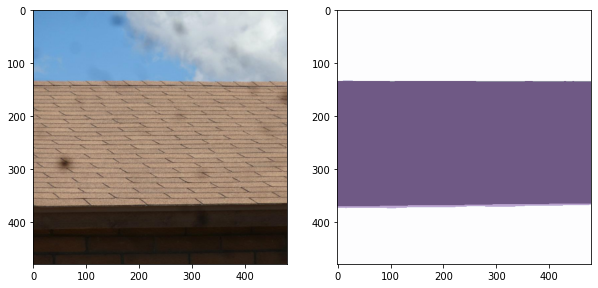

02B3614901_2015042/009.JPG


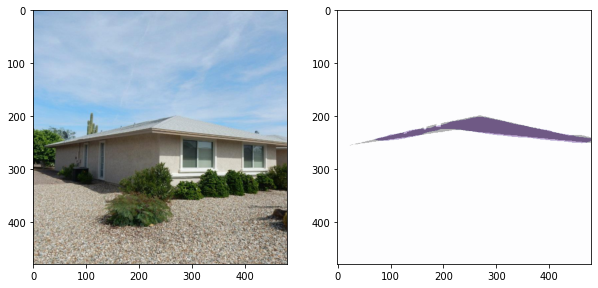

02B3204601_2015013/004.JPG


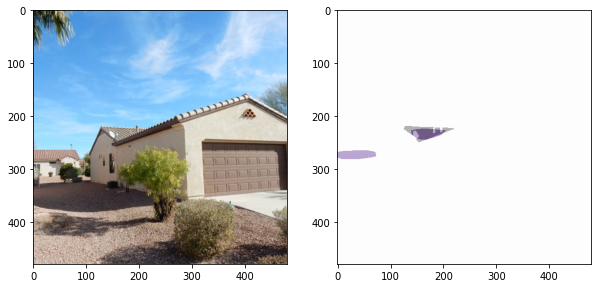

02B3885101_2015061/002.JPG


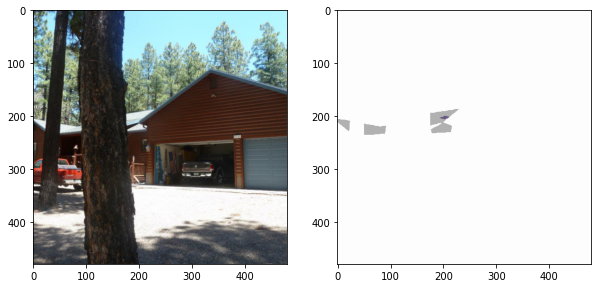

02B3622701_2015042/003.JPG


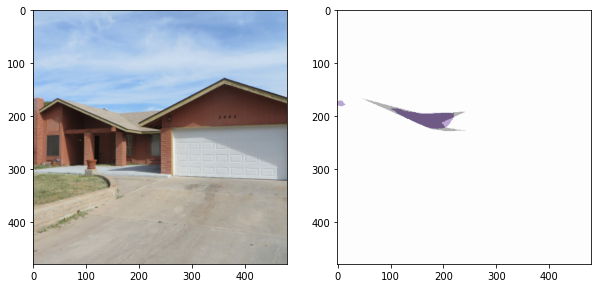

02B3740201_2015051/006.JPG


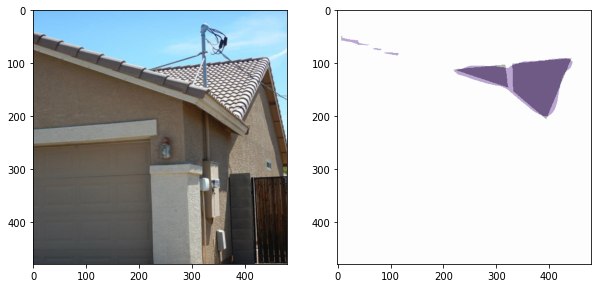

02B3189501_2015011/007.JPG


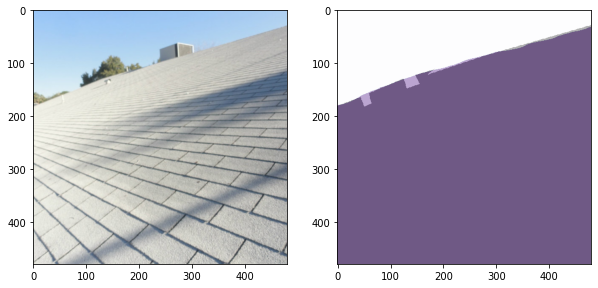

02B4080901_2015071/013.JPG


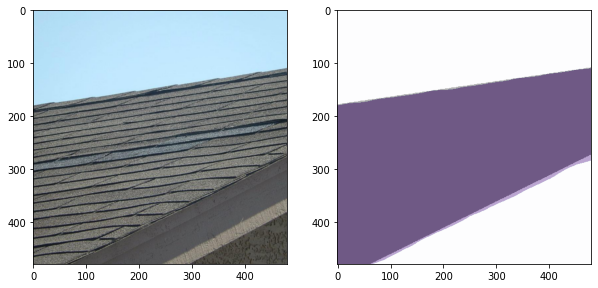

02B3384901_2015023/008.JPG


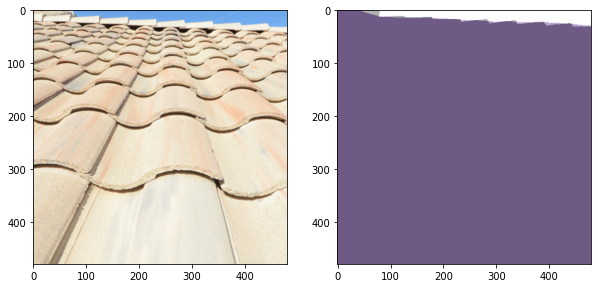

02B0106301_2015111/009.JPG


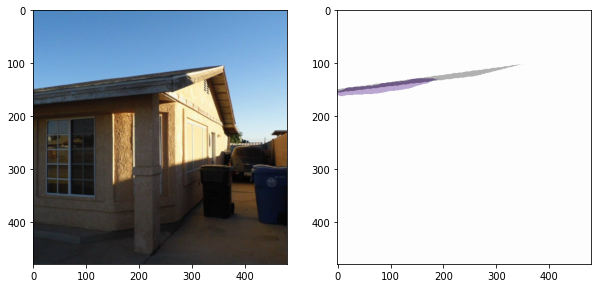

02B3743901_2015101/003.JPG


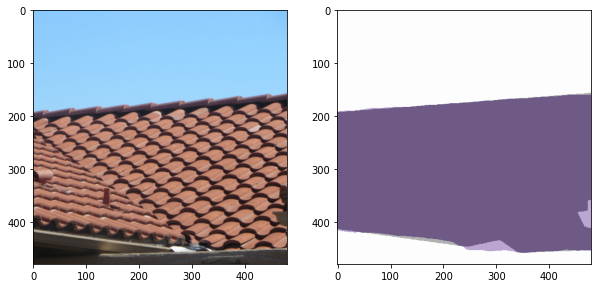

02B3384901_2015023/008.JPG


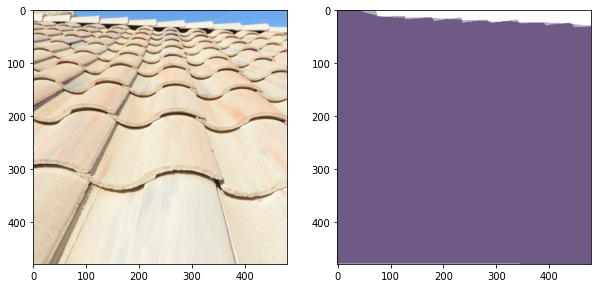

02B1197001_2015041/012.JPG


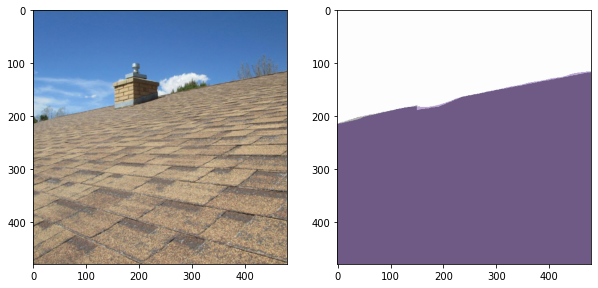

02B3740201_2015051/004.JPG


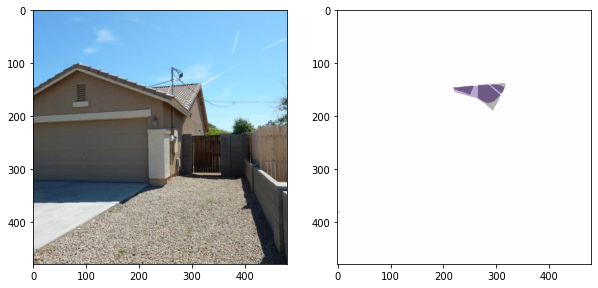

02B1224001_2017015/005.JPG


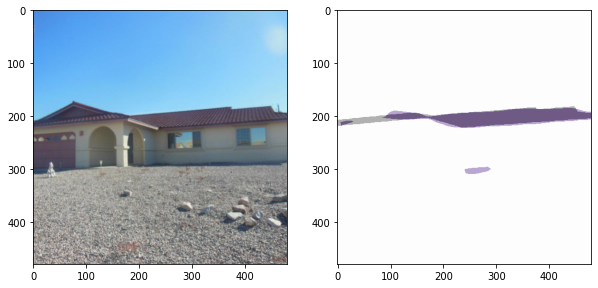

02B4039201_2015062/002.JPG


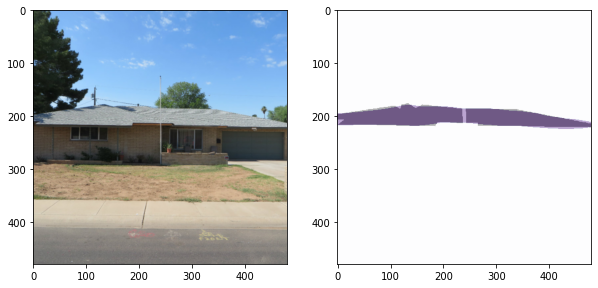

02B3728901_2015051/011.JPG


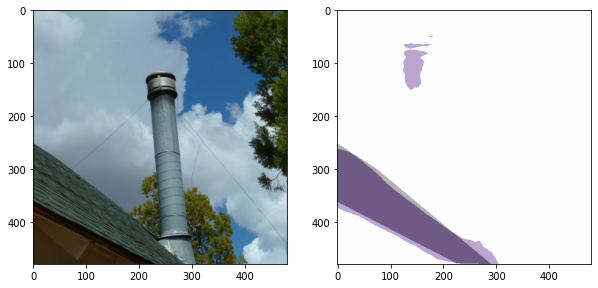

02B3937201_2015061/010.JPG


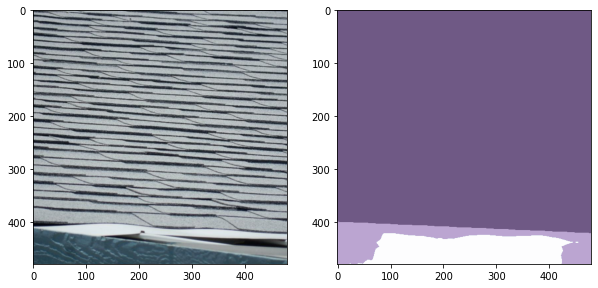

02B3478701_2015031/012.JPG


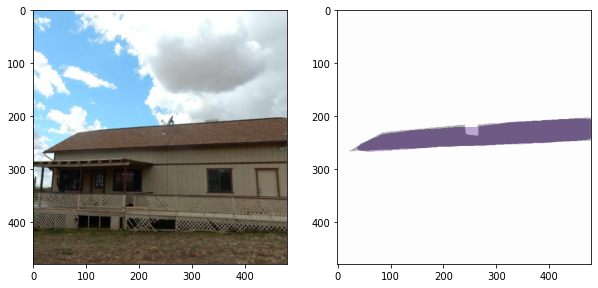

02B3739001_2015051/003.JPG


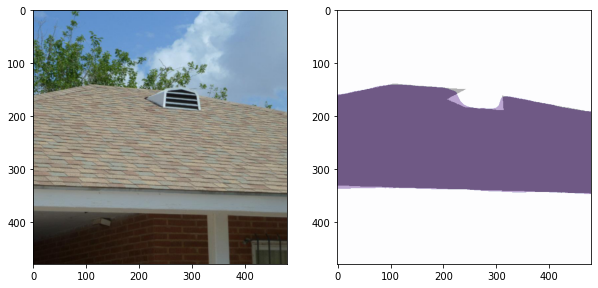

02B3612901_2015042/007.JPG


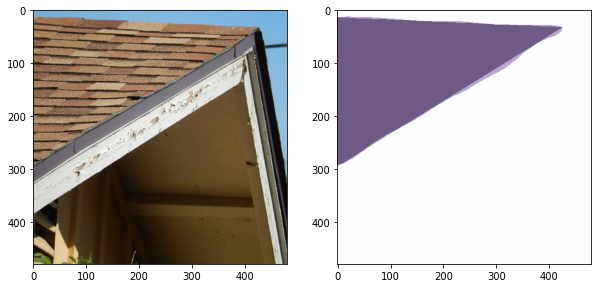

02B3440401_2015031/003.JPG


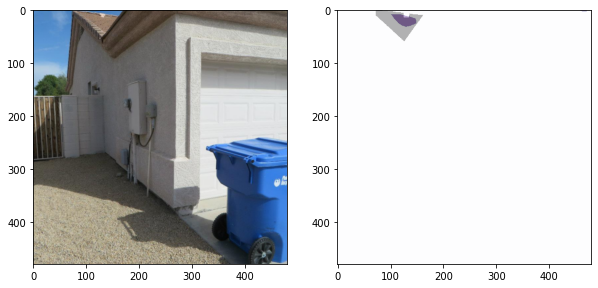

02B2347701_2015023/006.JPG


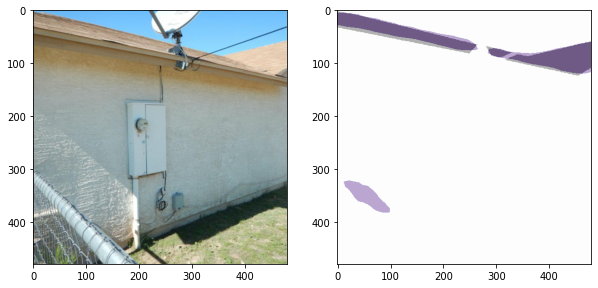

02B3716501_2015044/007.JPG


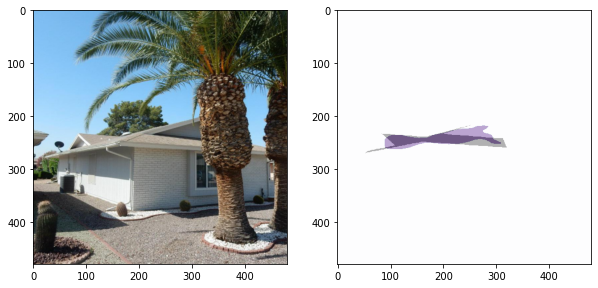

02B3207101_2015011/006.JPG


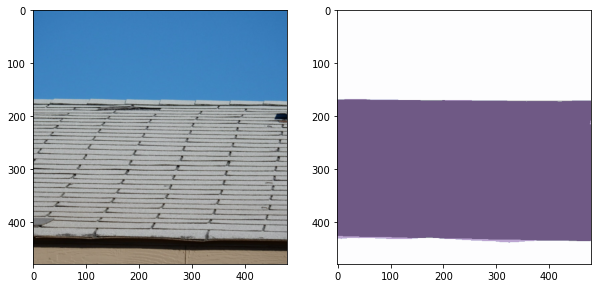

02B3796301_2015051/006.JPG


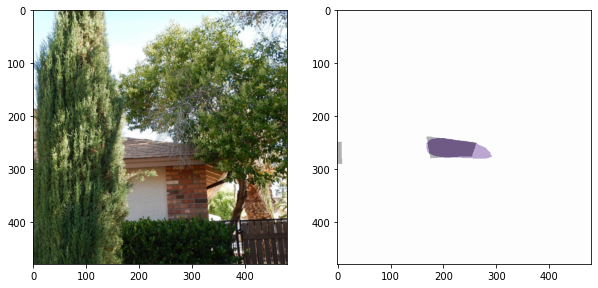

02B1375801_2016051/001.JPG


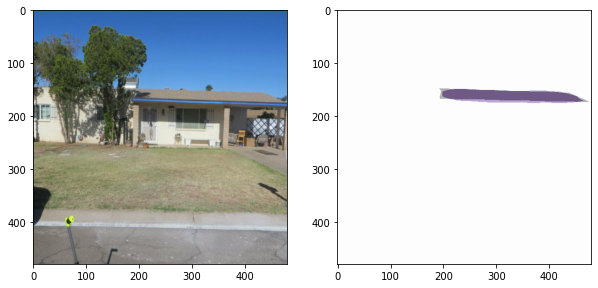

02B3664701_2015042/027.JPG


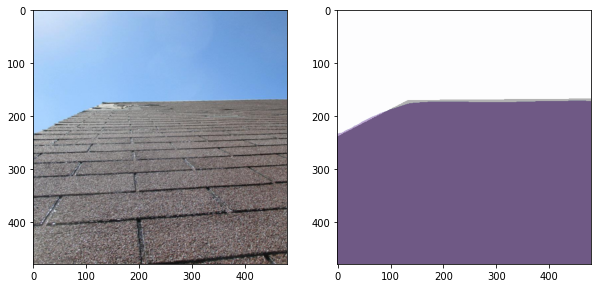

02B1054901_2017011/010.JPG


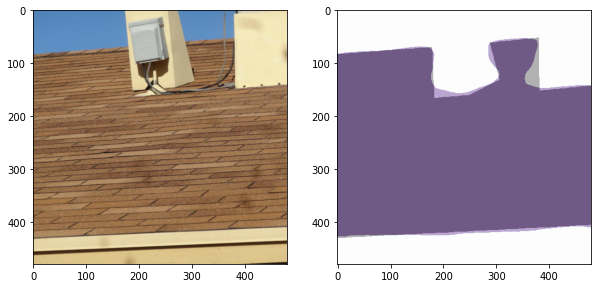

02B0858301_2015023/011.JPG


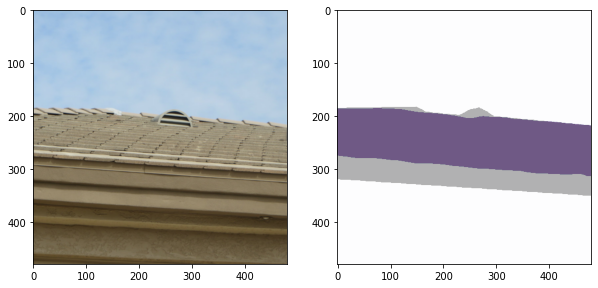

02B3983301_2015062/002.JPG


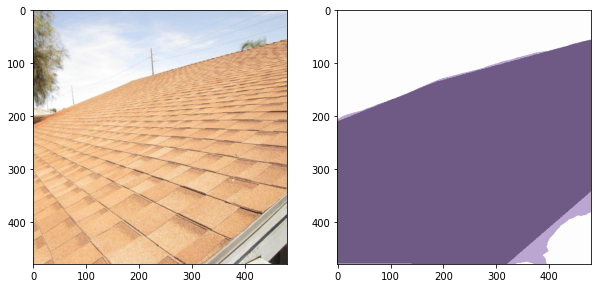

02B1439401_2016053/015.JPG


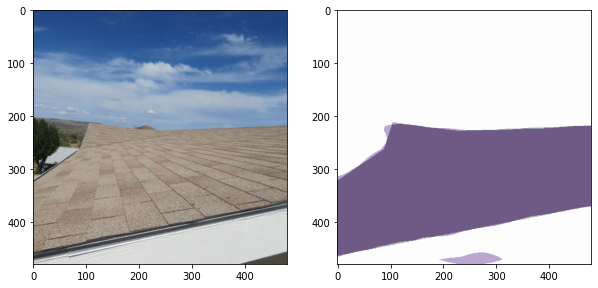

02B0268101_2015111/012.JPG


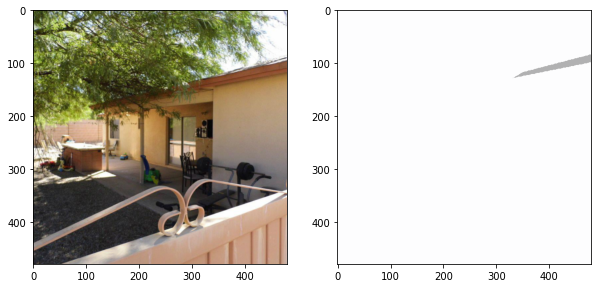

02B3787001_2015052/006.JPG


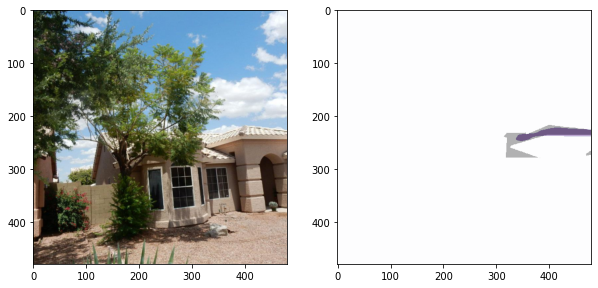

02B3777901_2015052/003.JPG


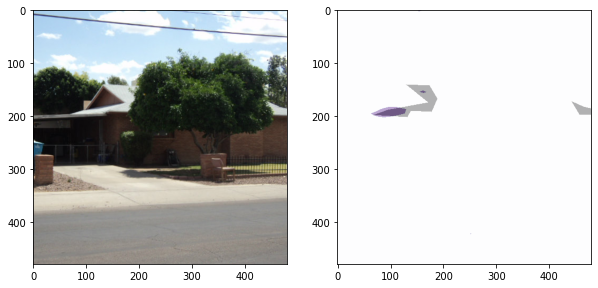

02B1380501_2017021/004.JPG


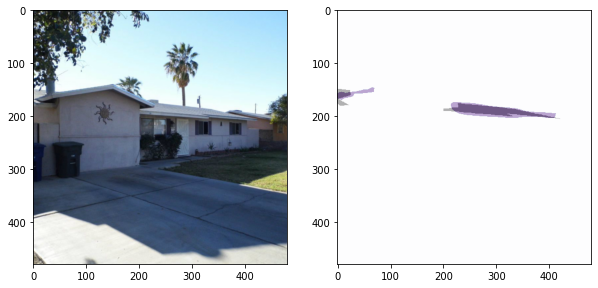

02B1439401_2016053/014.JPG


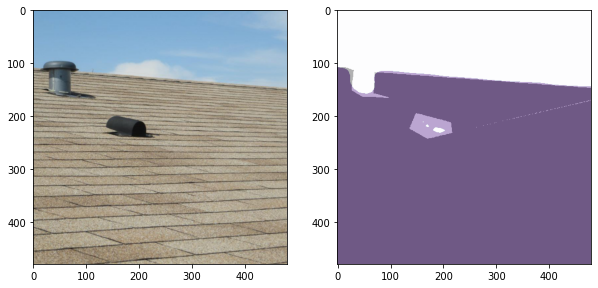

02B3361601_2015081/015.JPG


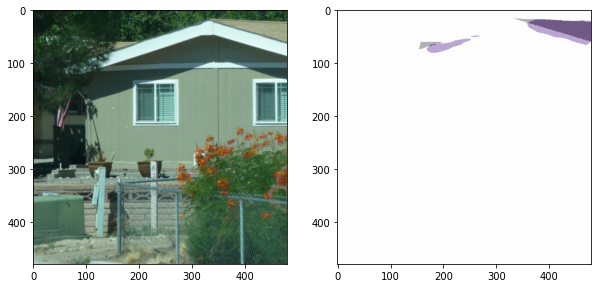

02B0539101_2015101/004.JPG


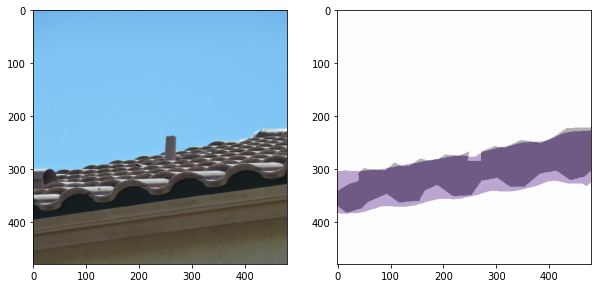

02B3812501_2015052/002.JPG


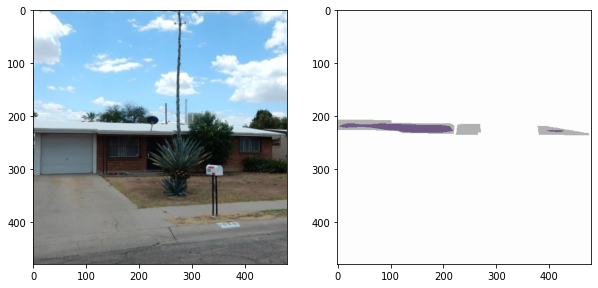

02B3290101_2015014/005.JPG


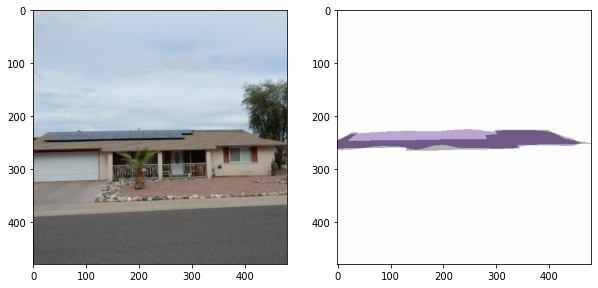

02B0221301_2017064/016.JPG


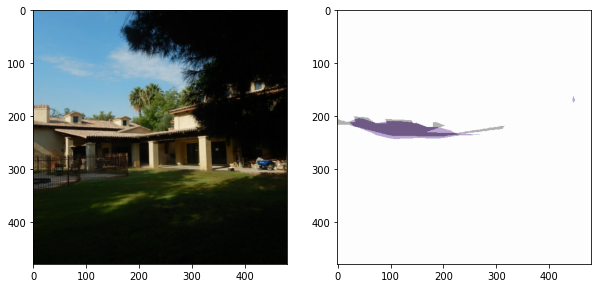

02B3641601_2015042/007.JPG


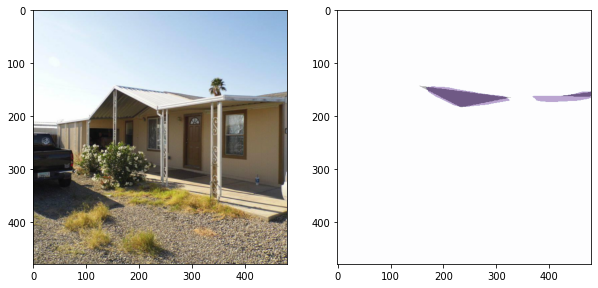

02B3461301_2015031/005.JPG


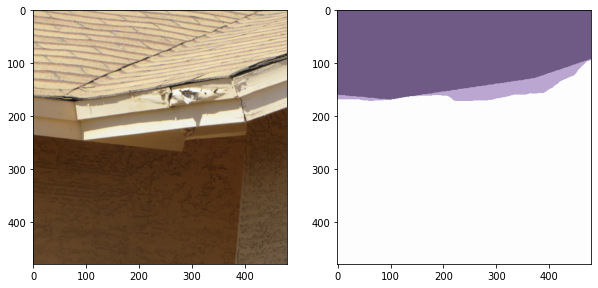

02B3539901_2015033/013.JPG


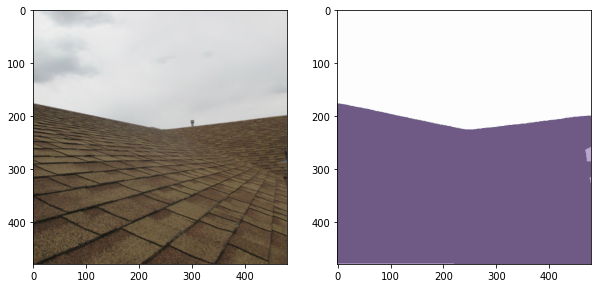

02B3415701_2015041/012.JPG


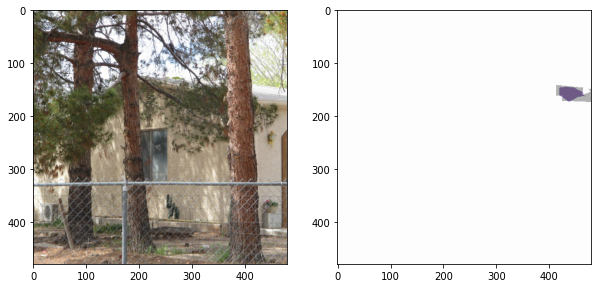

02B4035201_2015063/014.JPG


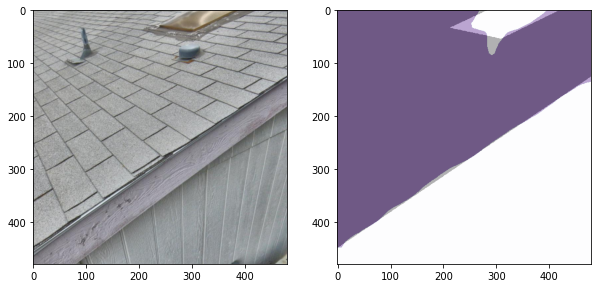

02B3064601_2015013/016.JPG


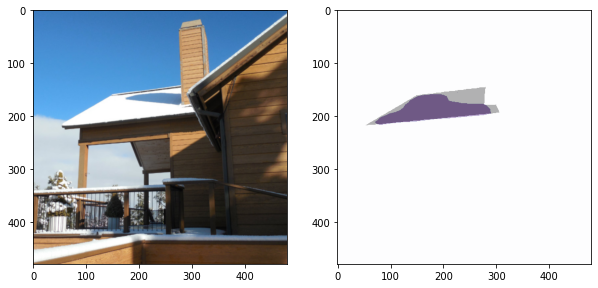

02B3664701_2015042/020.JPG


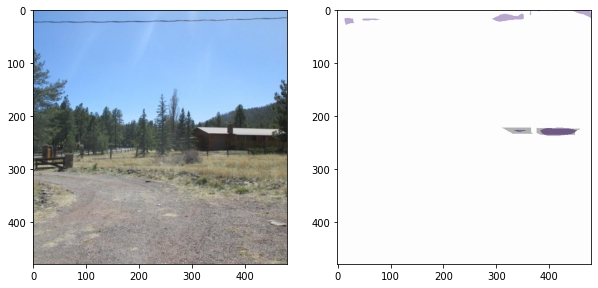

02B4022801_2015062/001.JPG


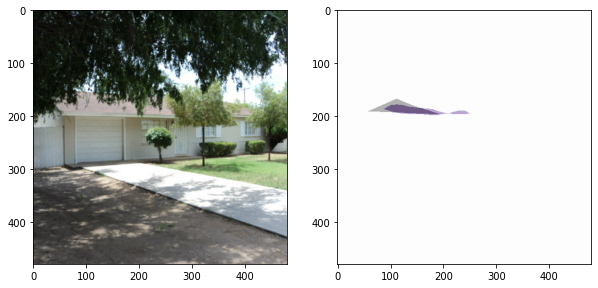

02B3684201_2015043/009.JPG


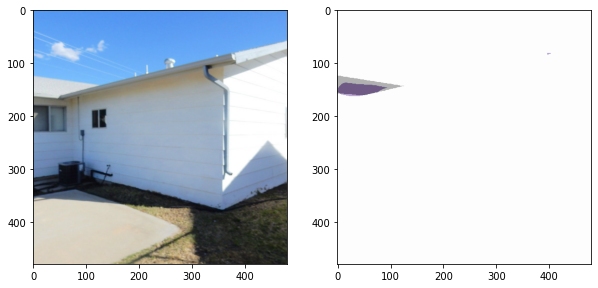

02B3903801_2015055/009.JPG


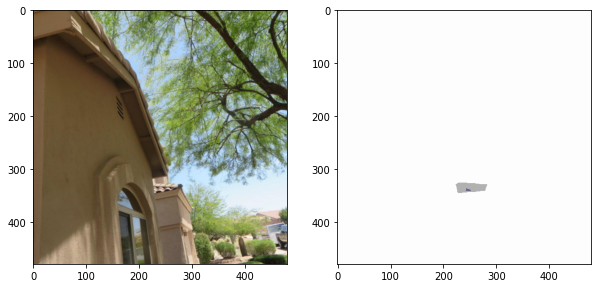

02B4131901_2015072/012.JPG


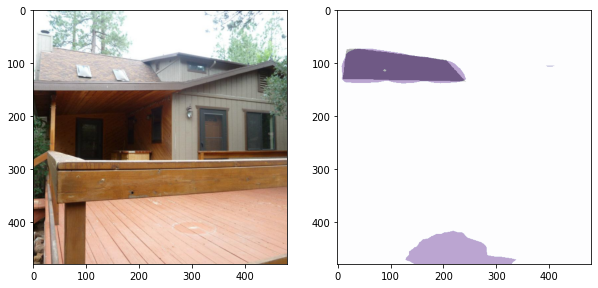

02B3751301_2015052/009.JPG


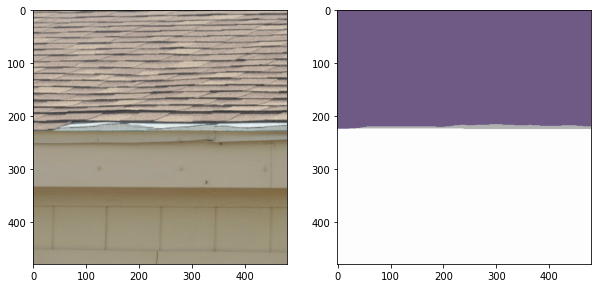

02B3670101_2015043/008.JPG


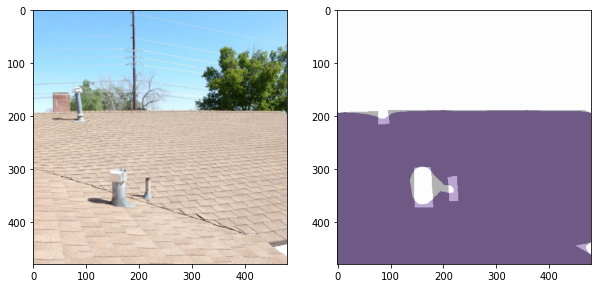

02B3972901_2015061/002.JPG


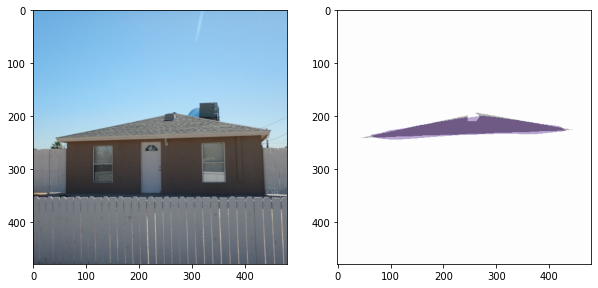

02B2939401_2016103/010.JPG


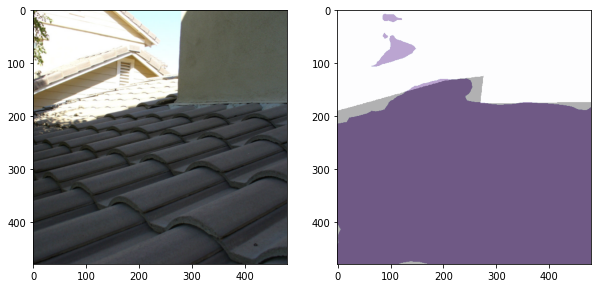

02B4023001_2015062/003.JPG


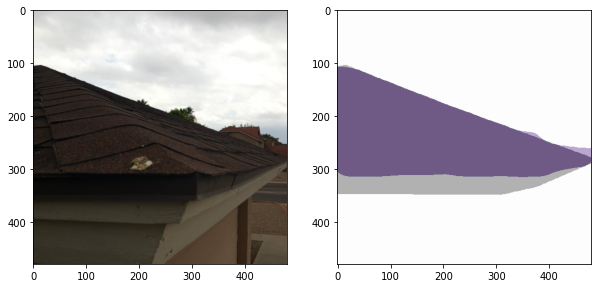

02B3948601_2015062/003.JPG


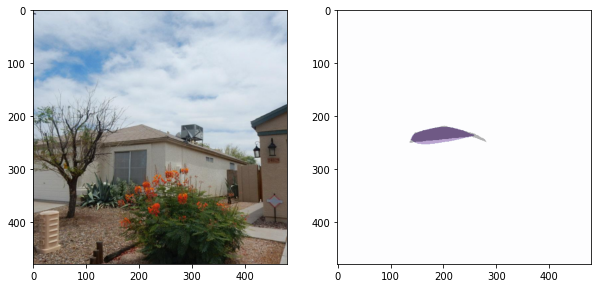

02B0347401_2015113/004.JPG


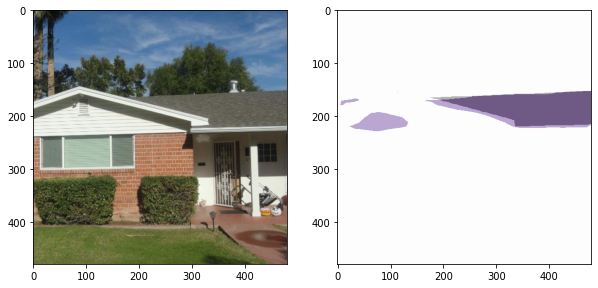

02B3199301_2015014/002.JPG


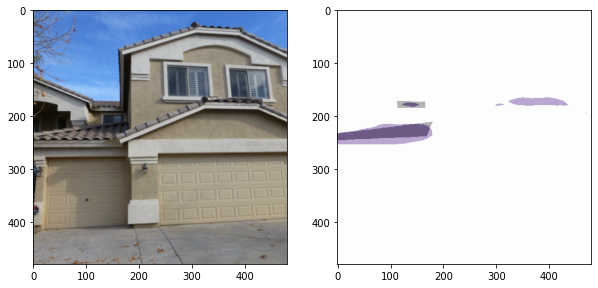

02B3373601_2015022/011.JPG


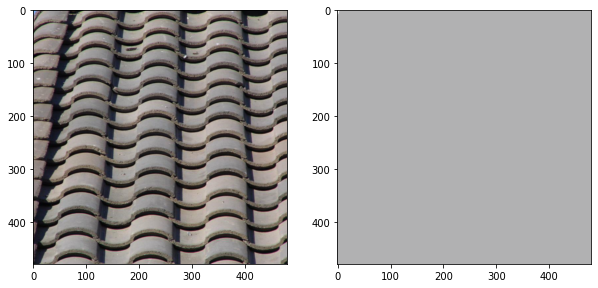

02B3410101_2015033/019.JPG


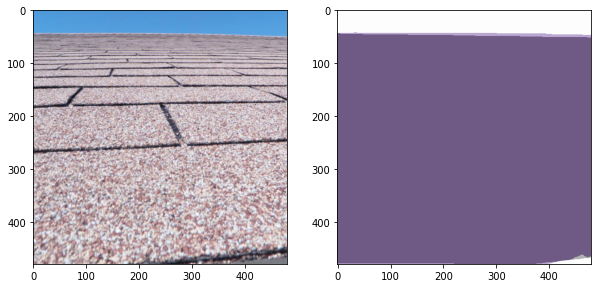

02B3373501_2015023/018.JPG


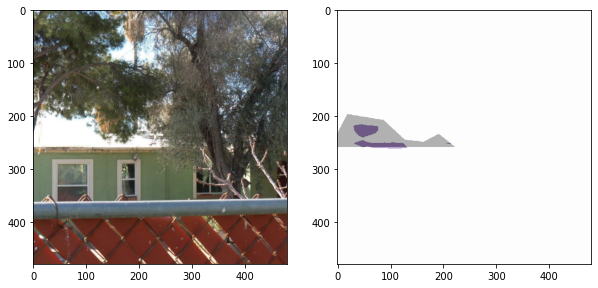

02B0884101_2016083/009.JPG


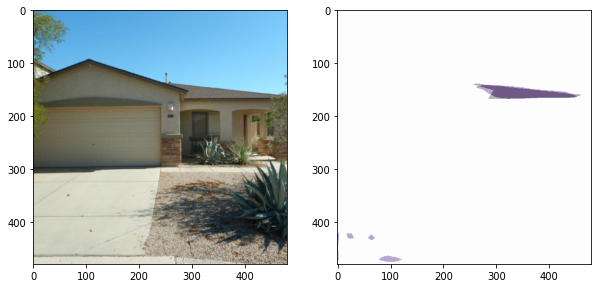

02B3971201_2015061/023.JPG


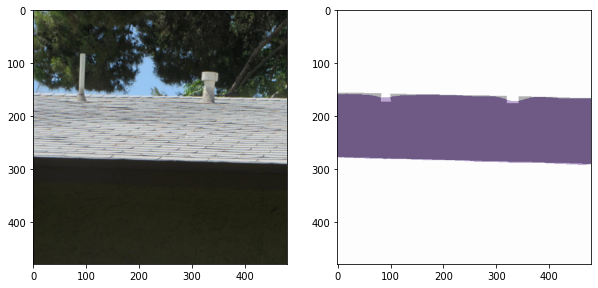

02B1368901_2016053/008.JPG


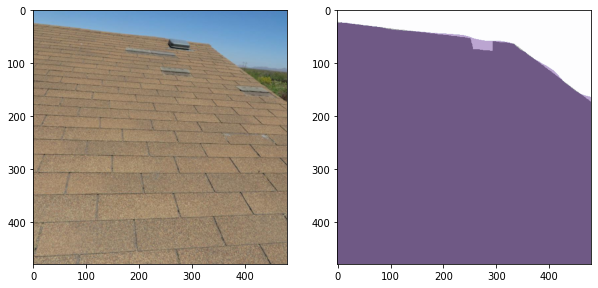

02B3061901_2015011/007.JPG


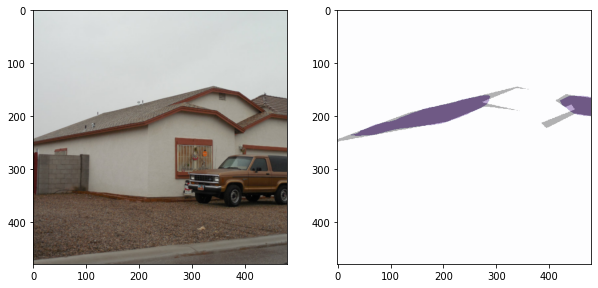

02B3965601_2015061/004.JPG


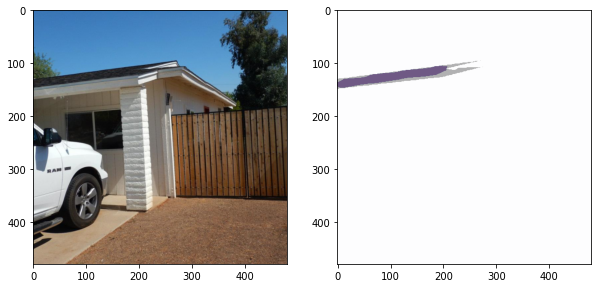

02B1564401_2016051/018.JPG


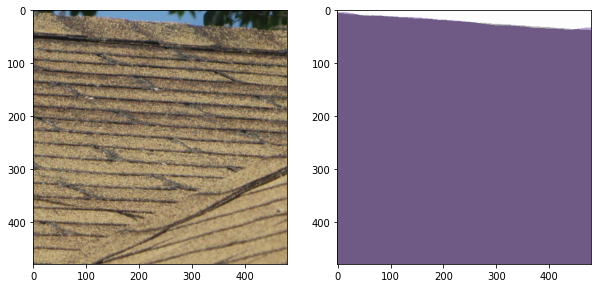

02B3747601_2015051/004.JPG


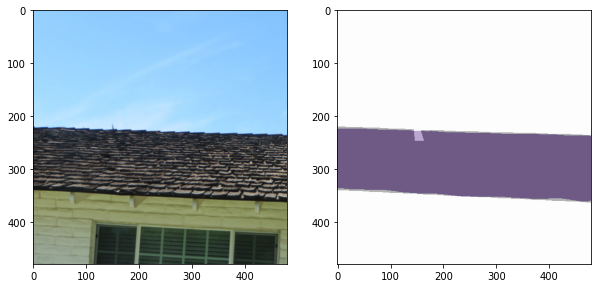

02B3206801_2016074/005.JPG


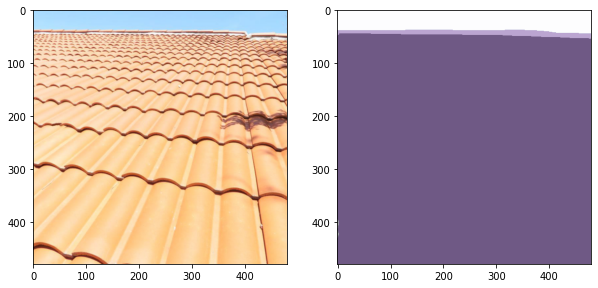

02B2934701_2015063/005.JPG


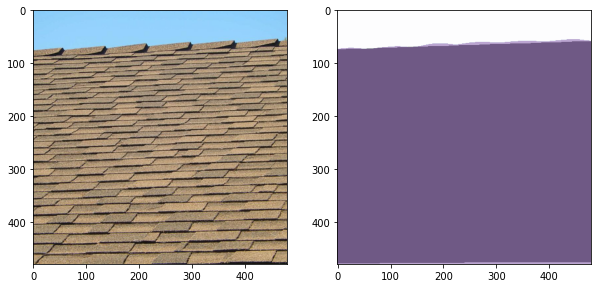

02B3435601_2015031/006.JPG


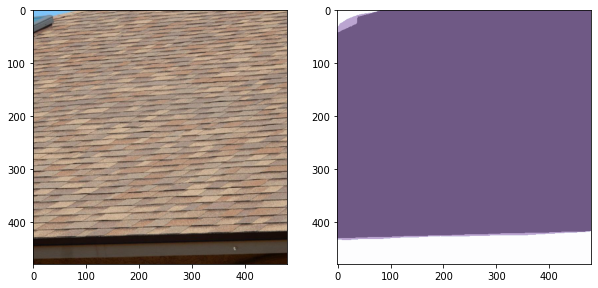

02B3383601_2015023/008.JPG


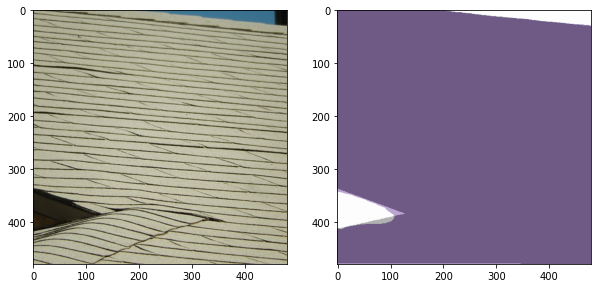

02B3452601_2015033/003.JPG


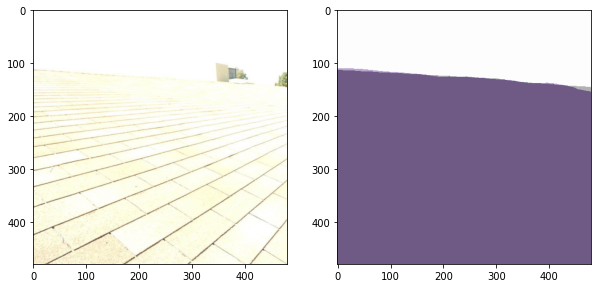

02B1410901_2016081/003.JPG


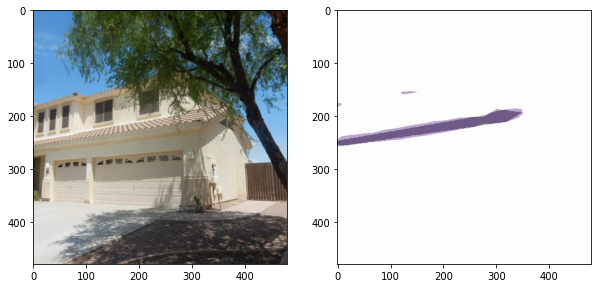

02B3614901_2015042/002.JPG


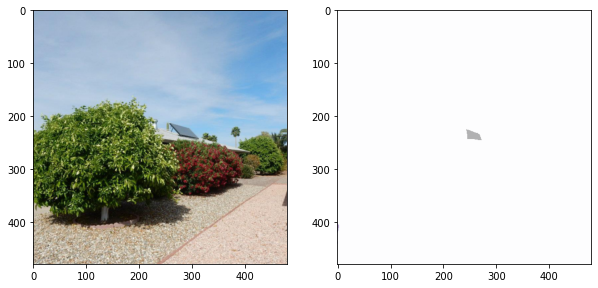

02B3290101_2015014/005.JPG


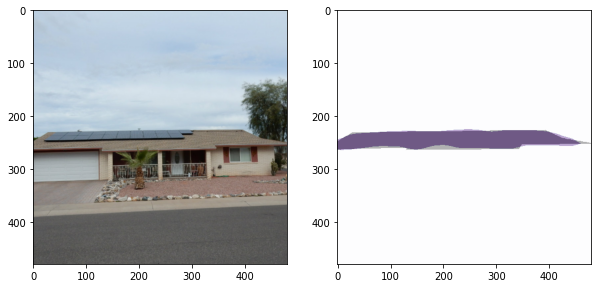

02B0030401_2015104/003.JPG


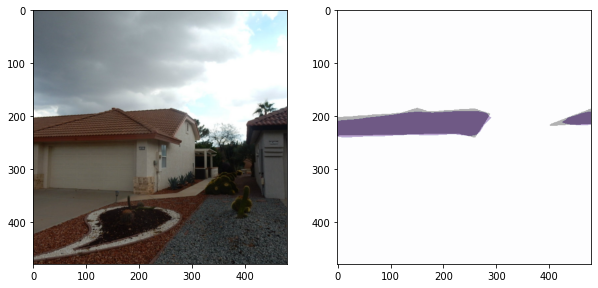

02B3310401_2015021/007.JPG


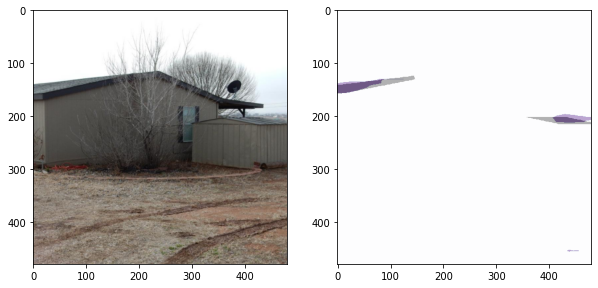

02B3909001_2015061/010.JPG


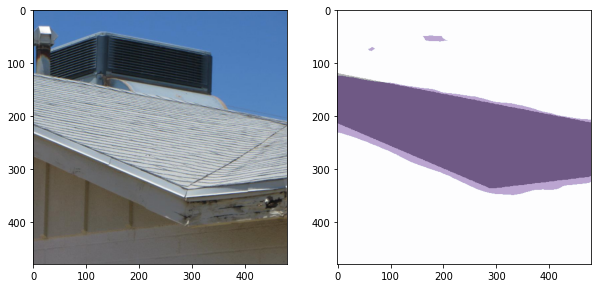

02B0171901_2015113/014.JPG


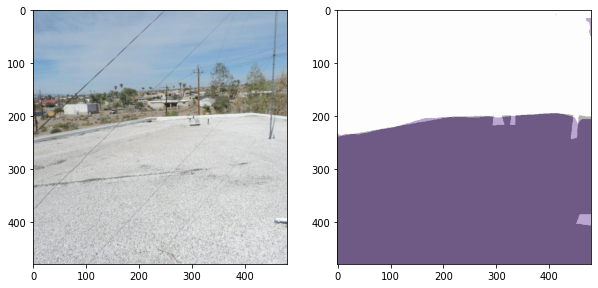

02B0753701_2016072/008.JPG


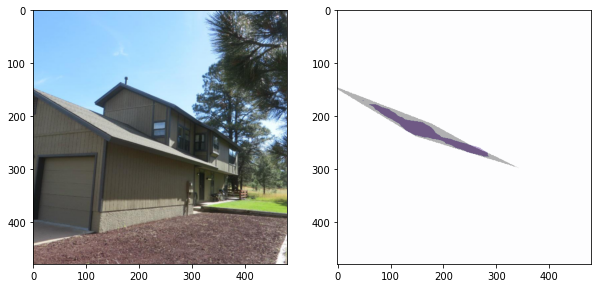

02B1512201_2016052/012.JPG


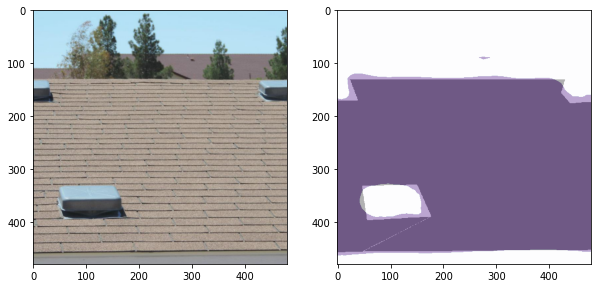

02B0015201_2015104/007.JPG


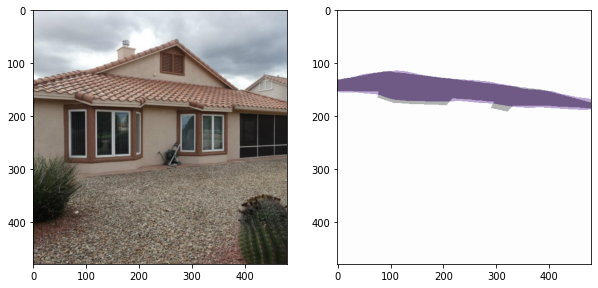

02B1937101_2015101/007.JPG


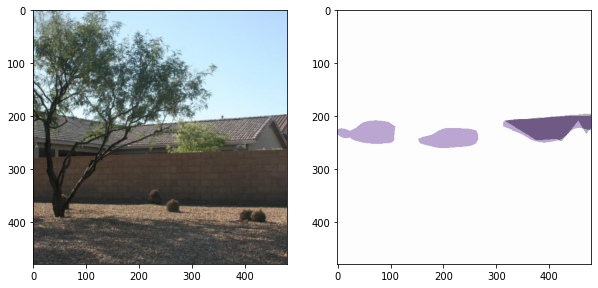

02B4062101_2015072/005.JPG


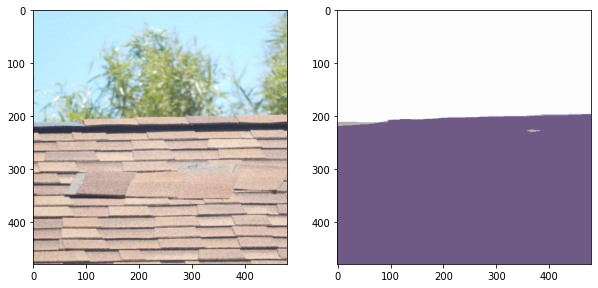

02B3987401_2015063/023.JPG


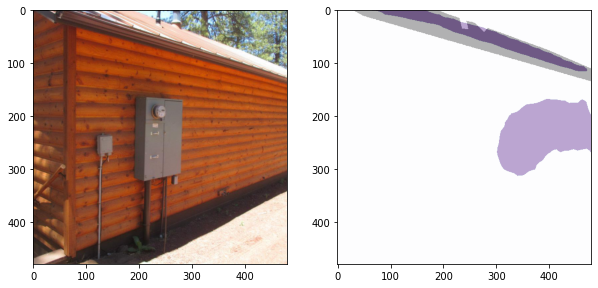

02B1379701_2015013/008.JPG


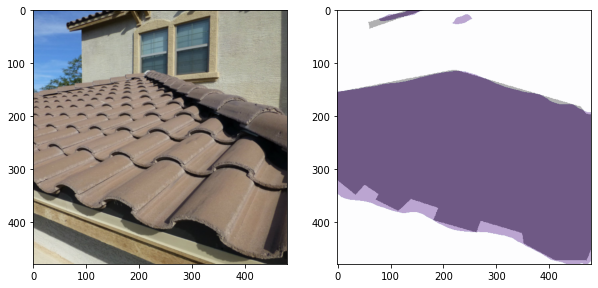

02B3688801_2015044/006.JPG


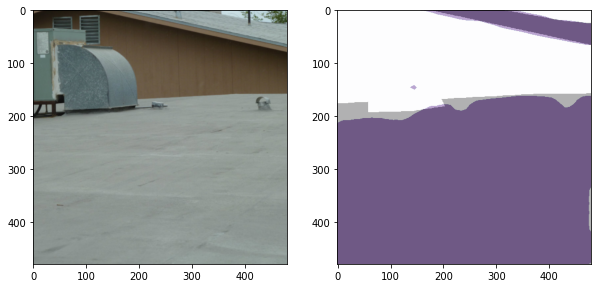

02B3659401_2015043/007.JPG


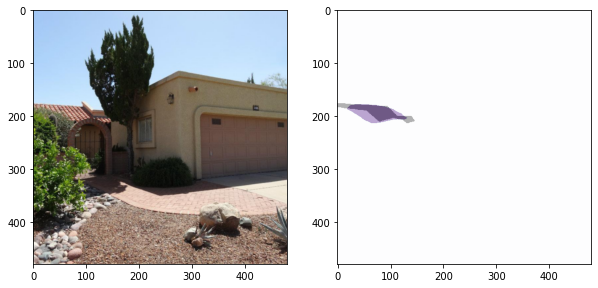

02B3435601_2015031/006.JPG


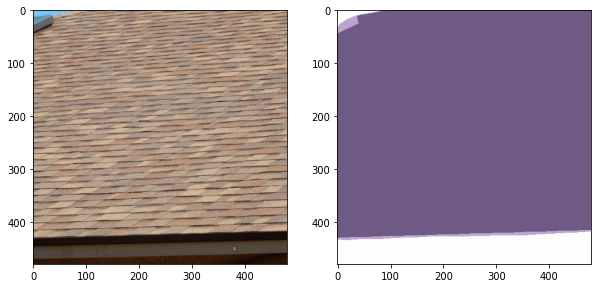

02B3931501_2015061/004.JPG


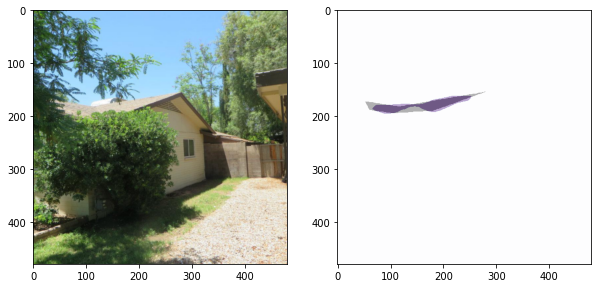

02B3739001_2015051/007.JPG


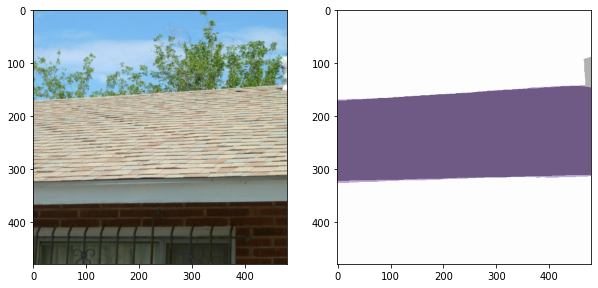

02B3201701_2015012/019.JPG


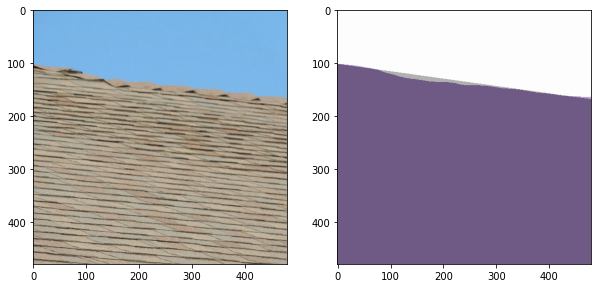

02B0184501_2015111/007.JPG


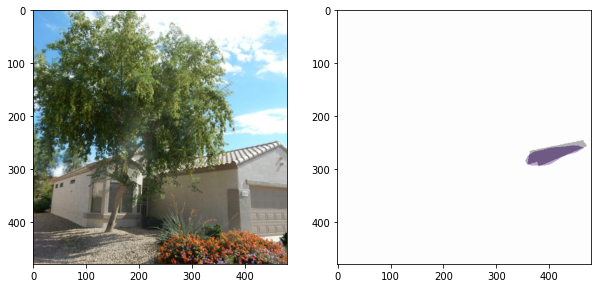

02B3979301_2015062/004.JPG


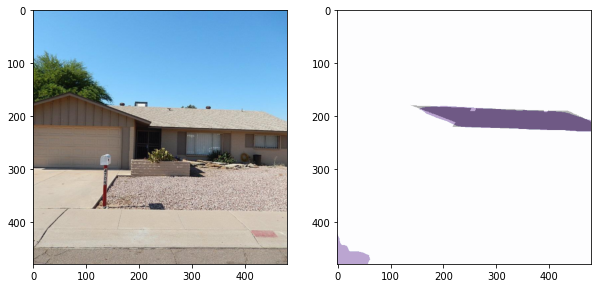

02B3393001_2015085/006.JPG


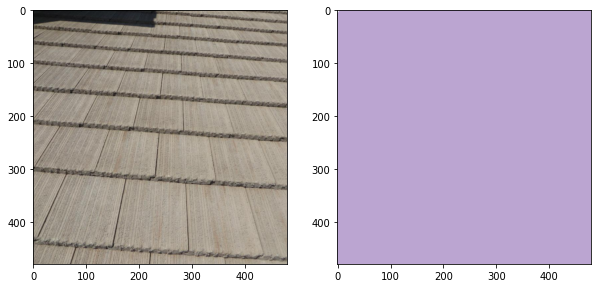

02B1512201_2016052/013.JPG


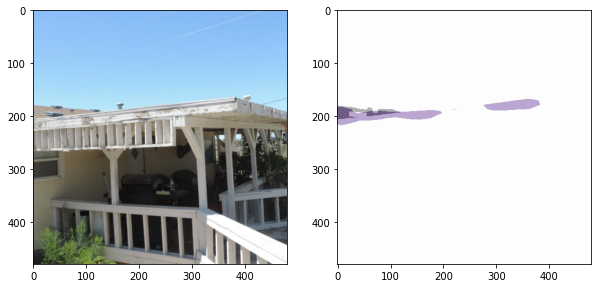

02B2422401_2015012/004.JPG


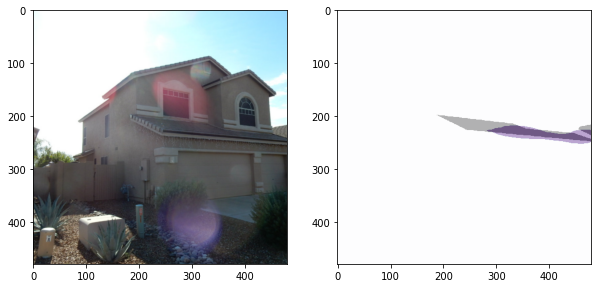

02B3373501_2015023/024.JPG


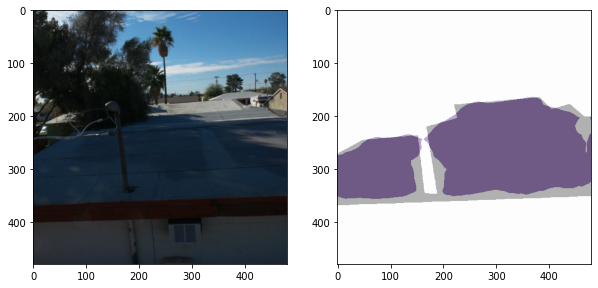

02B1857301_2016083/025.JPG


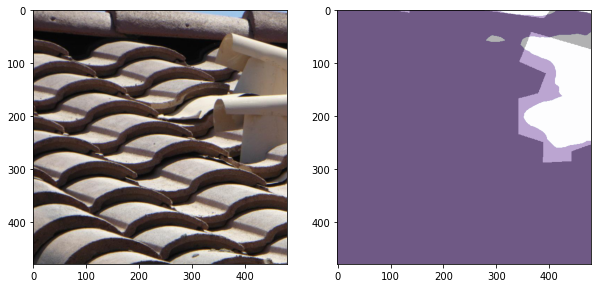

02B1512201_2016052/010.JPG


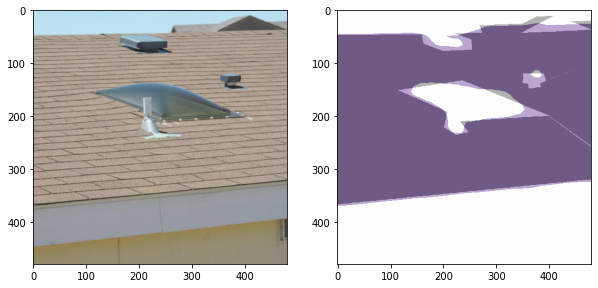

02B3943601_2015062/008.JPG


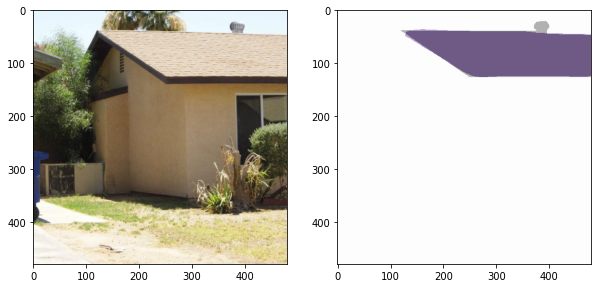

02B3620301_2015044/001.JPG


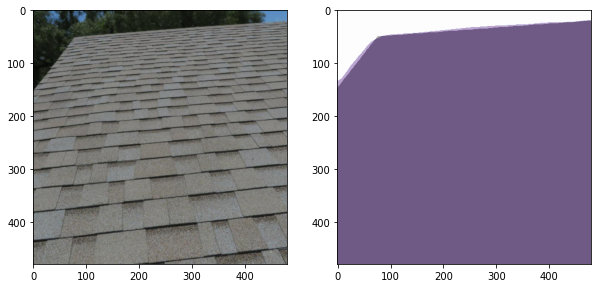

02B3909001_2015061/010.JPG


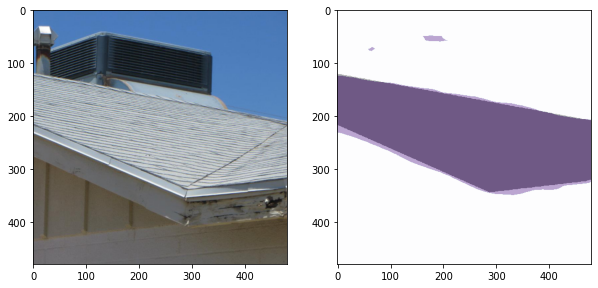

02B0242301_2015112/003.JPG


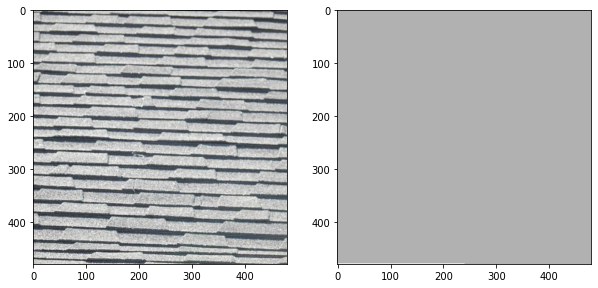

02B3846701_2015061/009.JPG


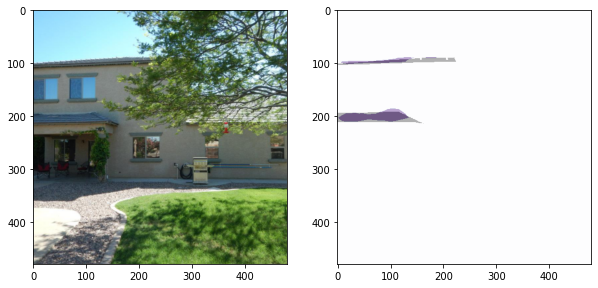

02B1251301_2016053/004.JPG


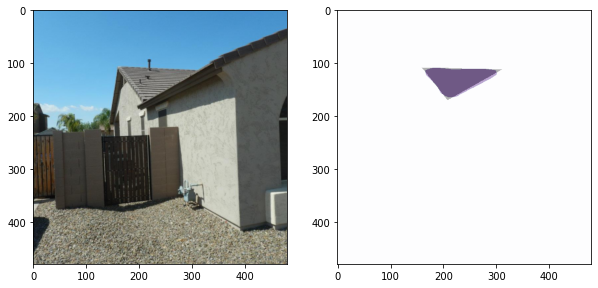

02B3636001_2015042/012.JPG


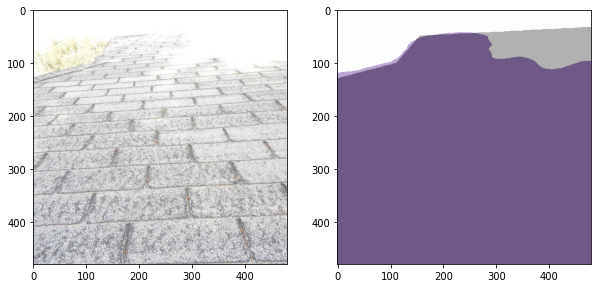

02B3852801_2015063/011.JPG


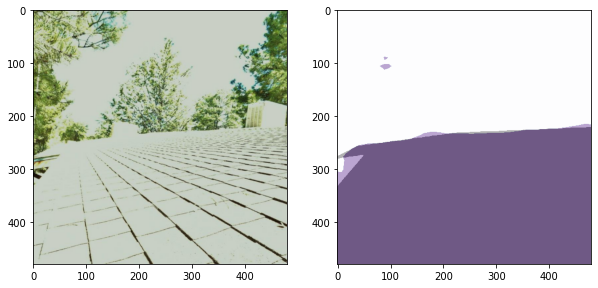

02B3197401_2015013/011.JPG


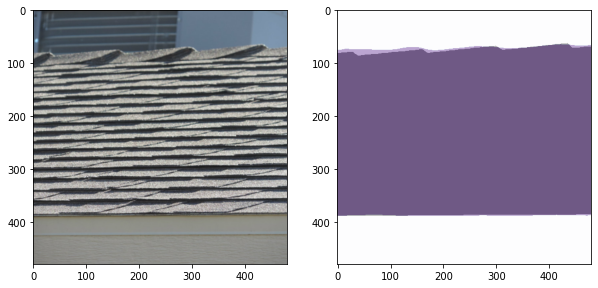

02B3254501_2015013/004.JPG


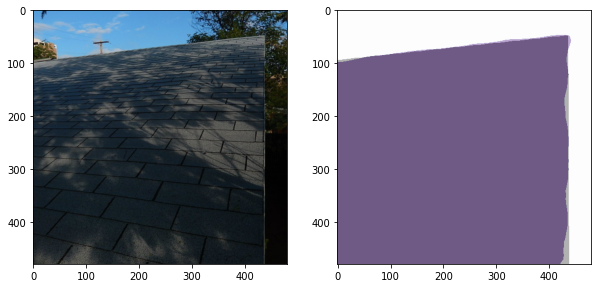

02B3618501_2015041/008.JPG


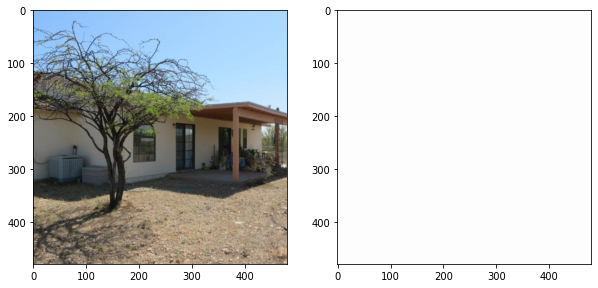

02B4020801_2015062/003.JPG


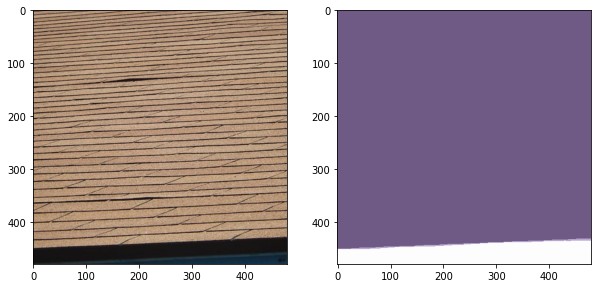

02B3852101_2015053/002.JPG


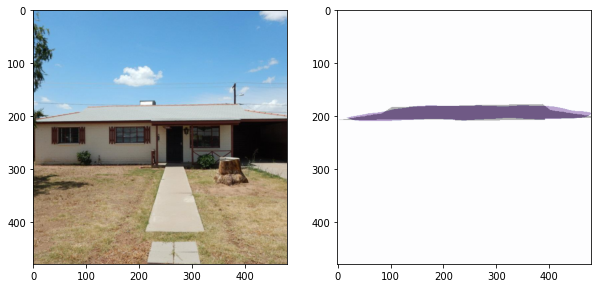

02B4062101_2015072/003.JPG


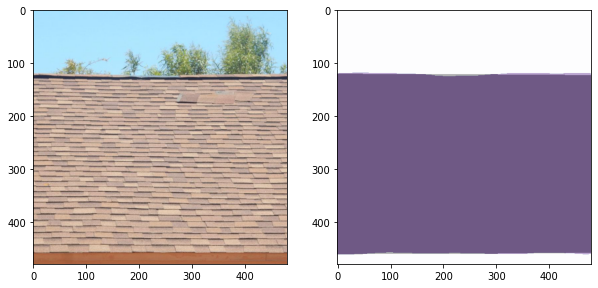

02B2347701_2015023/005.JPG


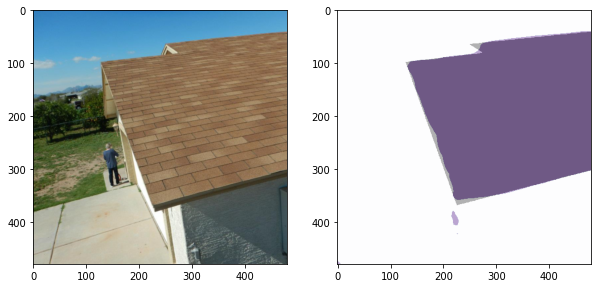

02B1229301_2017122/006.JPG


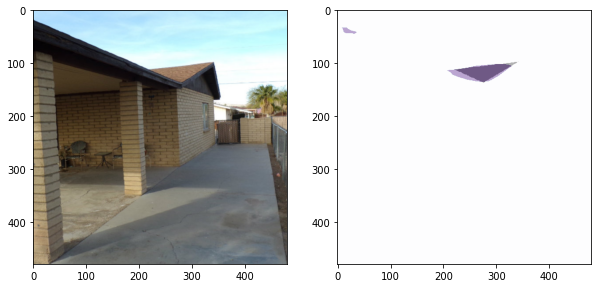

02B3903801_2015055/002.JPG


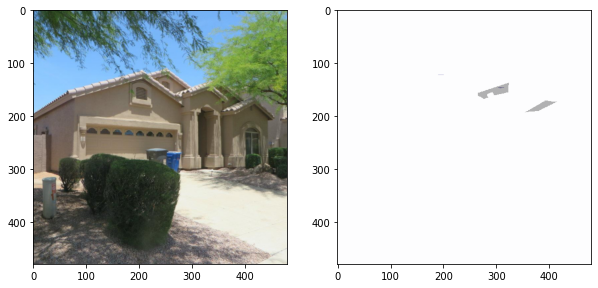

02B2075201_2016081/008.JPG


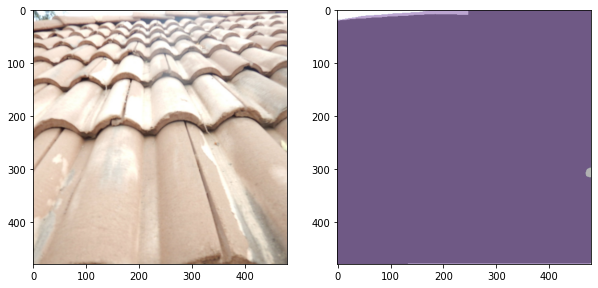

02B3394201_2015022/002.JPG


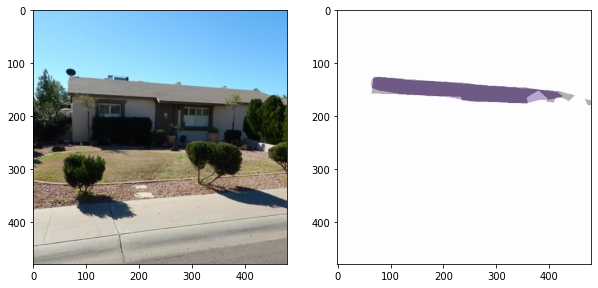

02B3190101_2015011/005.JPG


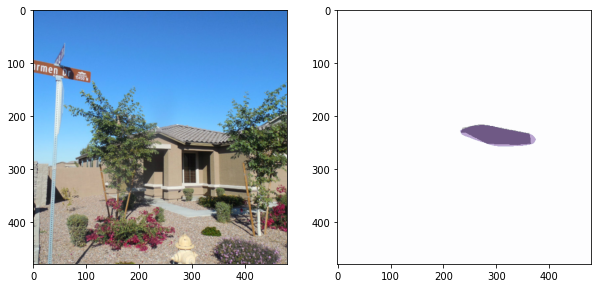

02B3357601_2015023/010.JPG


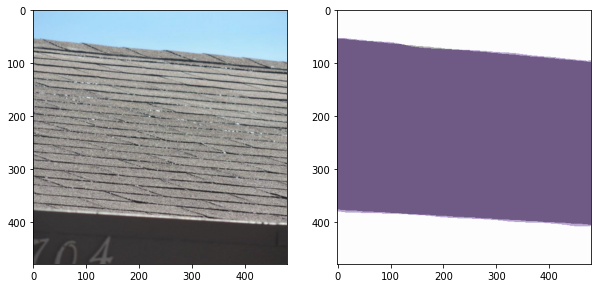

02B1386101_2016053/006.JPG


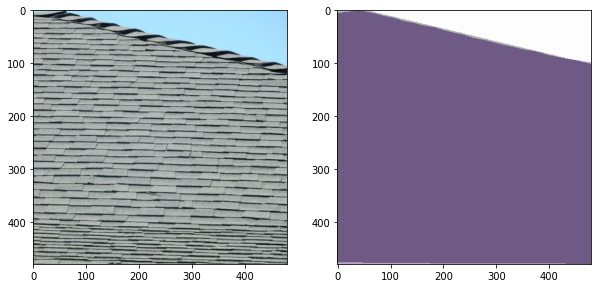

02B1393201_2016081/008.JPG


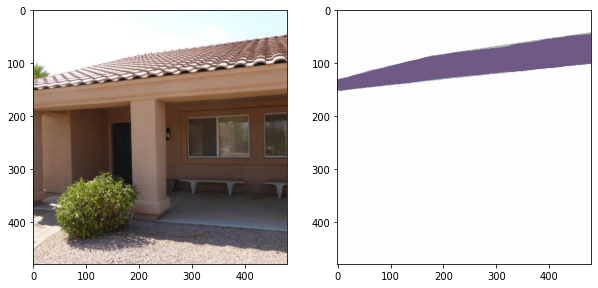

02B3205201_2015011/002.JPG


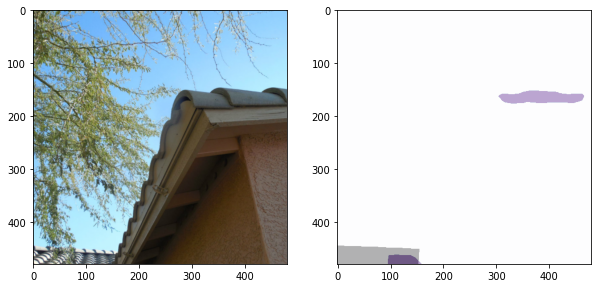

02B2022801_2015104/004.JPG


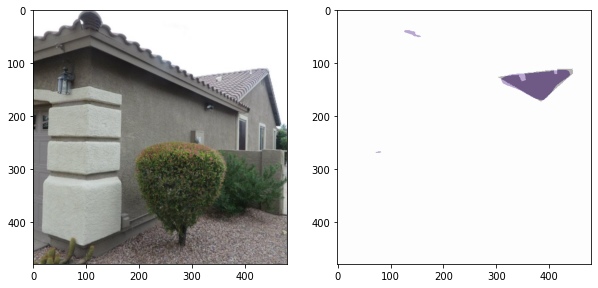

02B3571801_2015043/004.JPG


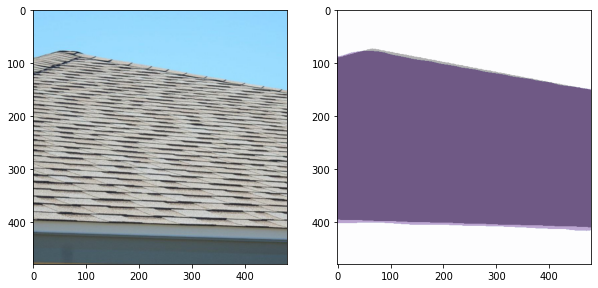

02B3383601_2015023/006.JPG


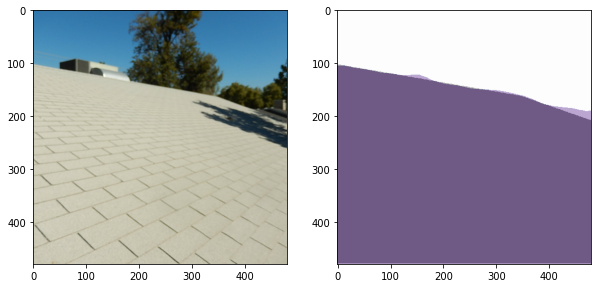

02B3245001_2015011/006.JPG


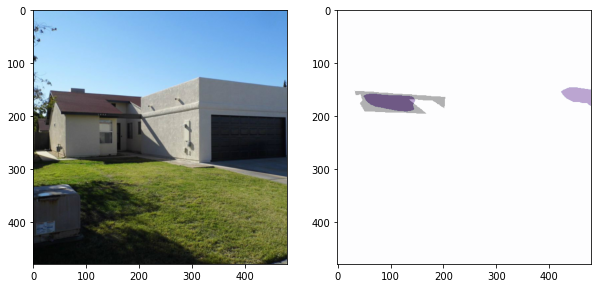

02B3698001_2015043/009.JPG


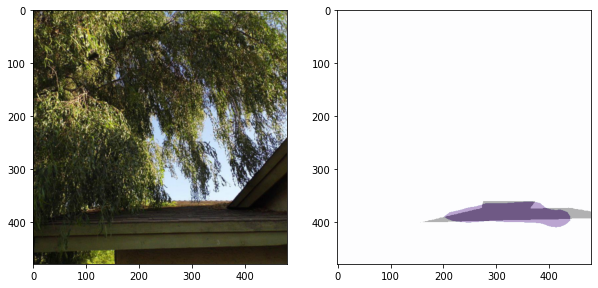

02B3442201_2015033/007.JPG


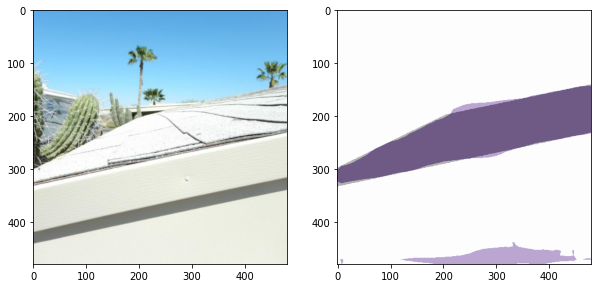

02B3267501_2015013/002.JPG


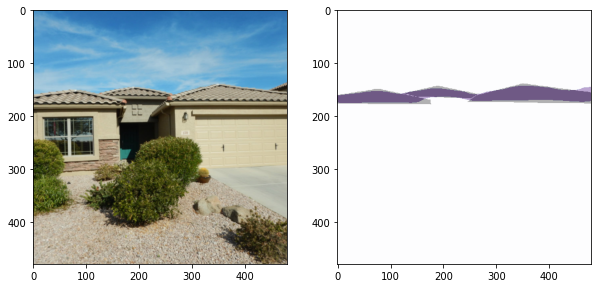

02B3268801_2015021/010.JPG


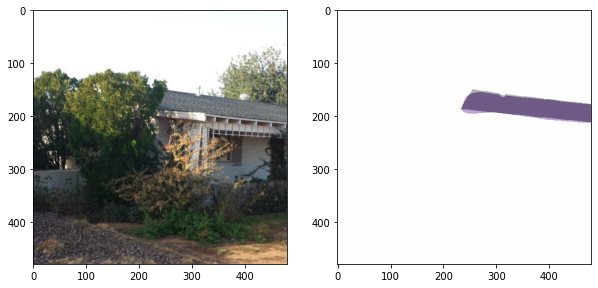

02B0855701_2016121/011.JPG


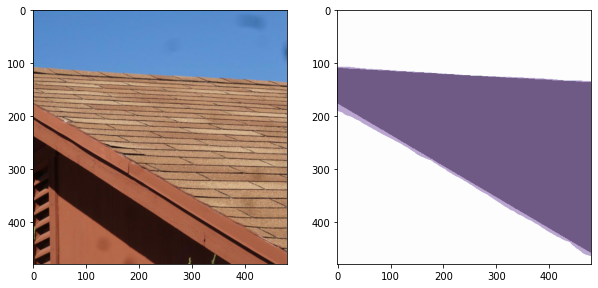

02B4057801_2015071/004.JPG


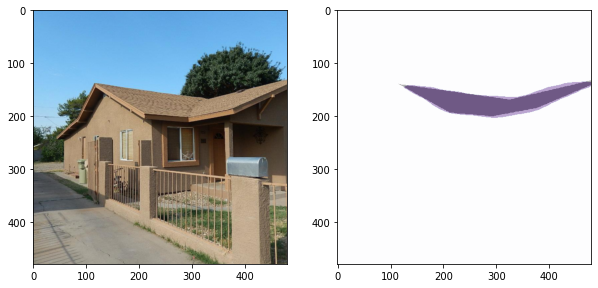

02B1595101_2016054/006.JPG


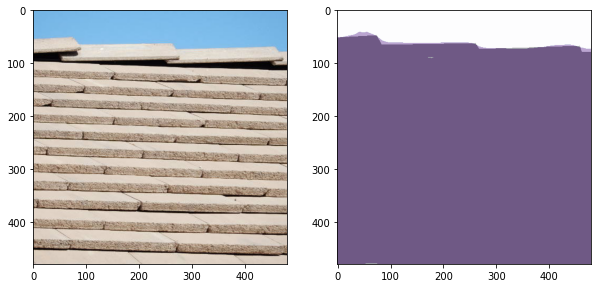

02B3697701_2015044/001.JPG


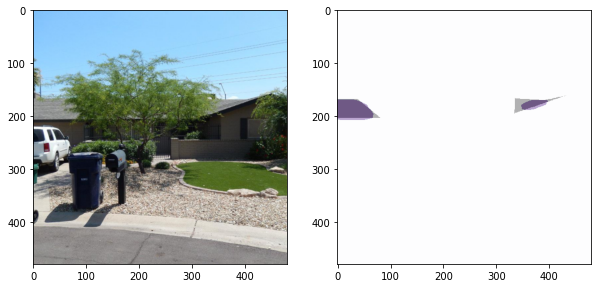

02B0623501_2015012/002.JPG


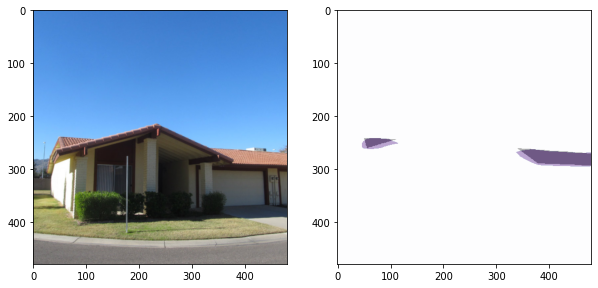

02B3592801_2015043/004.JPG


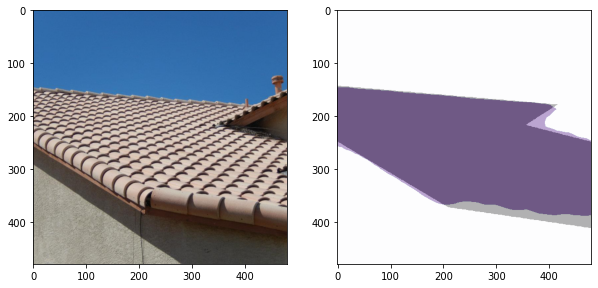

02B0200601_2015112/005.JPG


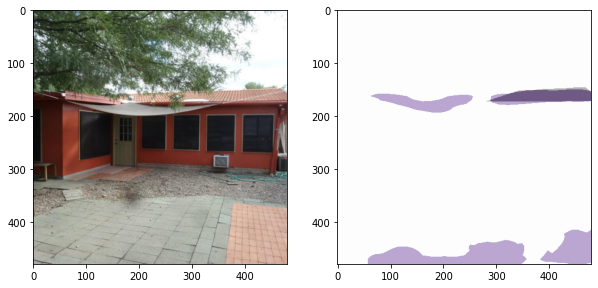

02B3796301_2015051/004.JPG


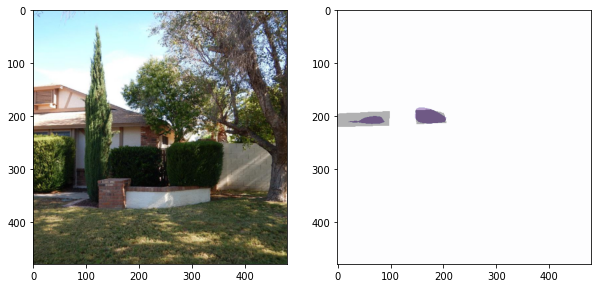

02B3614901_2015042/006.JPG


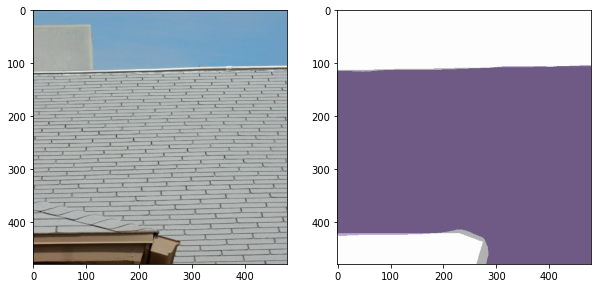

02B3739001_2015051/002.JPG


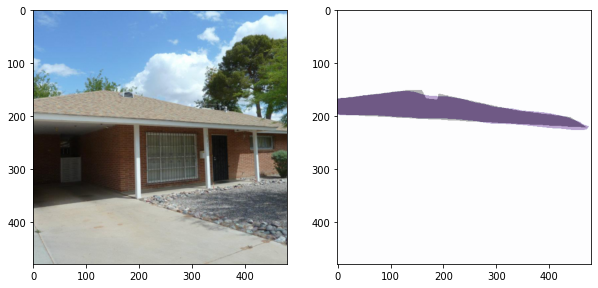

02B3798501_2015061/003.JPG


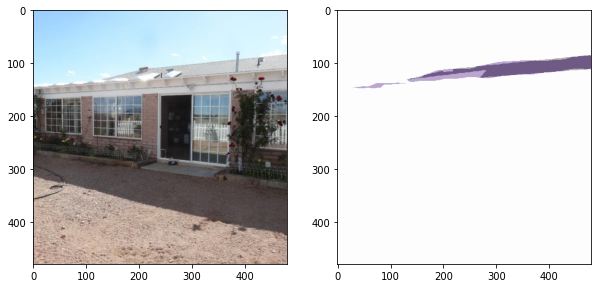

02B3611601_2015043/005.JPG


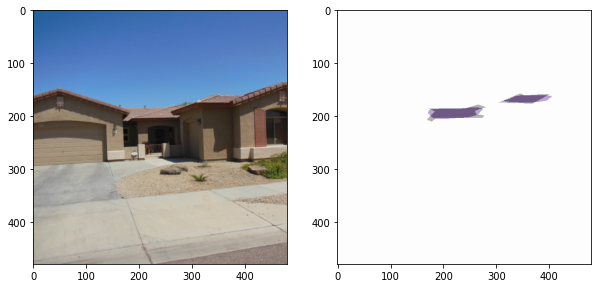

02B0501801_2016094/004.JPG


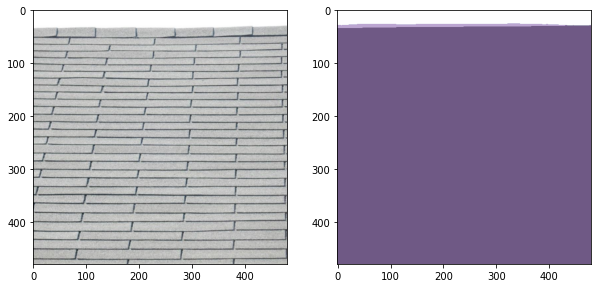

02B3373501_2015023/008.JPG


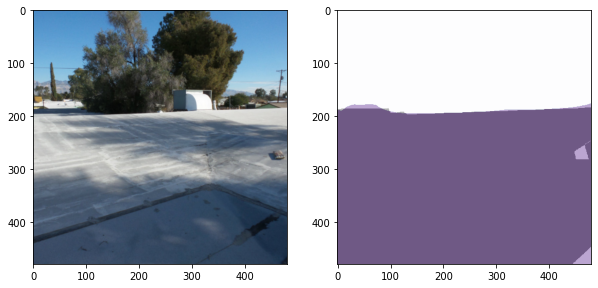

02B3994101_2015062/006.JPG


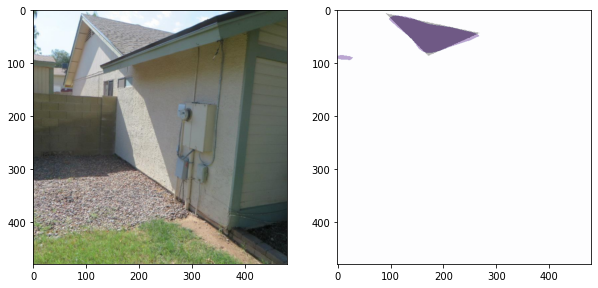

02B3903001_2015061/009.JPG


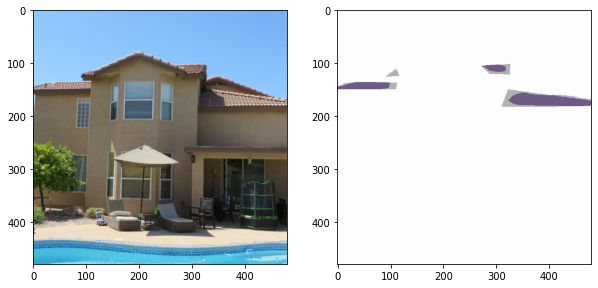

02B3252601_2015012/011.JPG


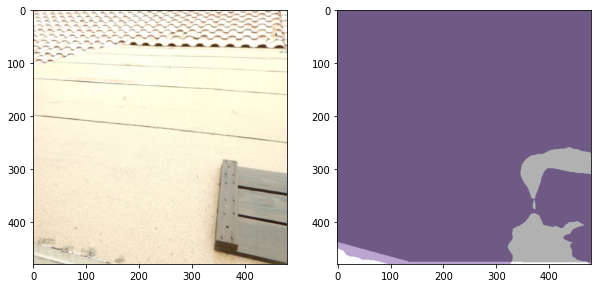

02B0039001_2015094/002.JPG


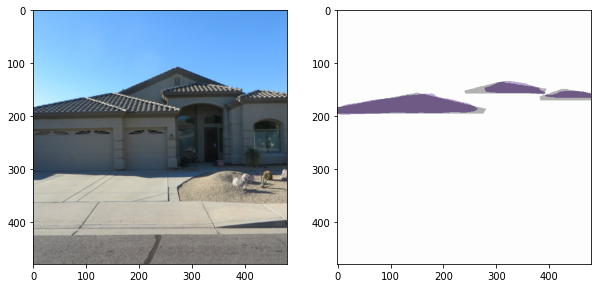

02B3869101_2016104/002.JPG


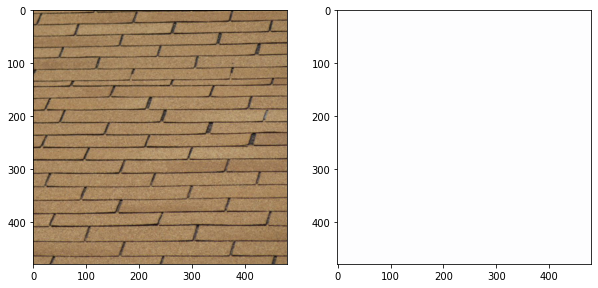

02B3796901_2015053/003.JPG


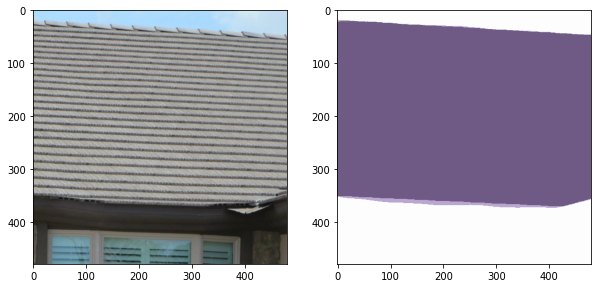

02B0666701_2017012/014.JPG


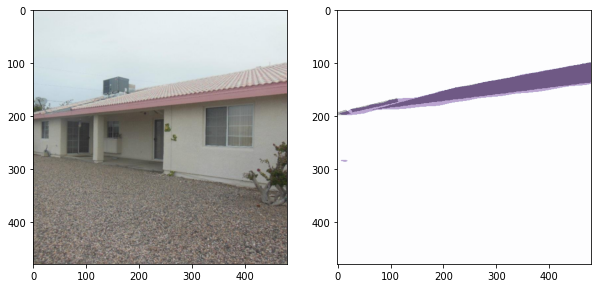

02B0147401_2015104/003.JPG


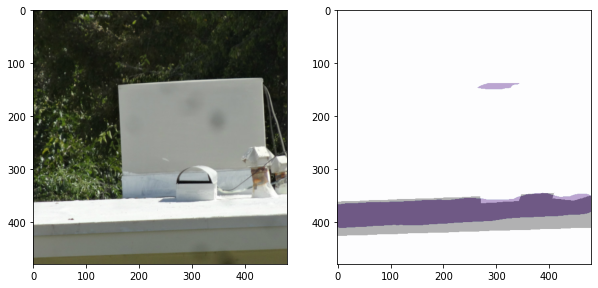

02B4102001_2015072/019.JPG


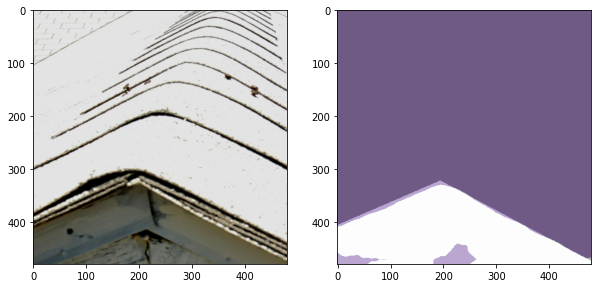

02B3534701_2015034/003.JPG


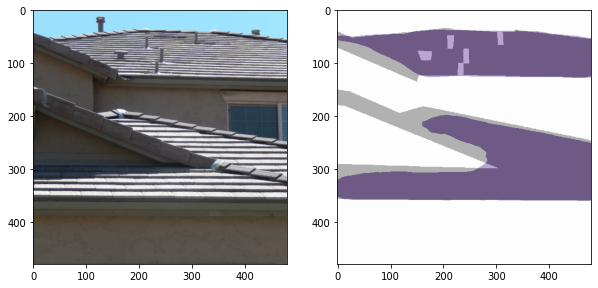

02B3948601_2015062/010.JPG


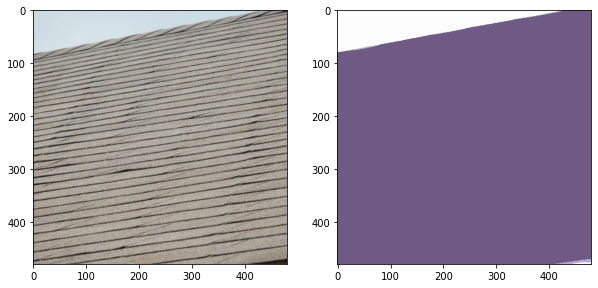

02B0753701_2016072/005.JPG


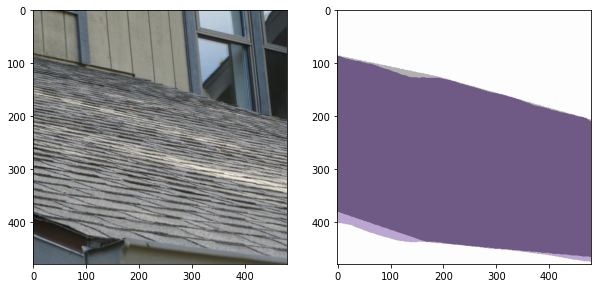

02B4113801_2015071/005.JPG


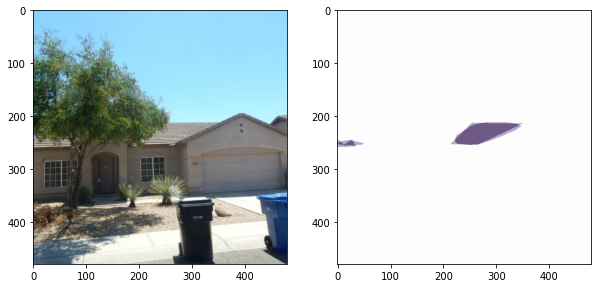

02B3271001_2015013/007.JPG


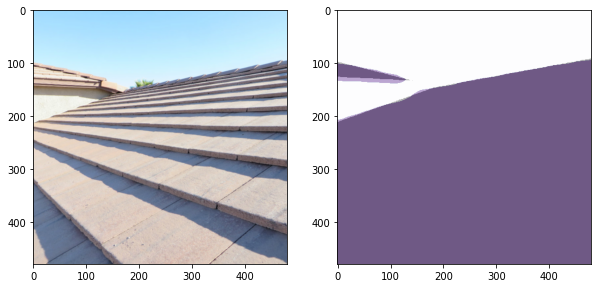

02B3433701_2015023/007.JPG


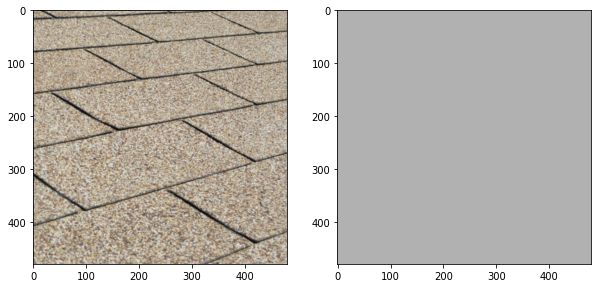

02B4102001_2015072/019.JPG


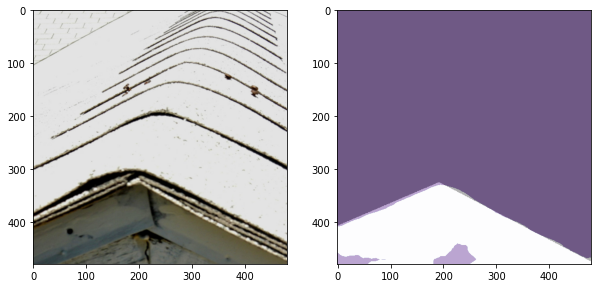

02B4085001_2015071/002.JPG


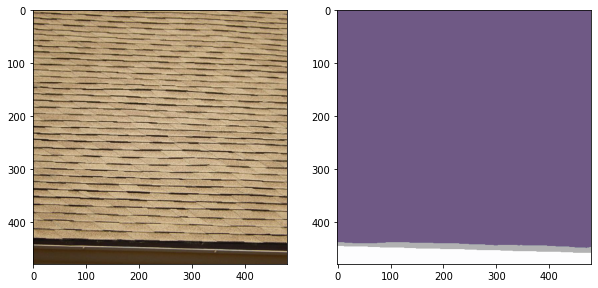

02B3361501_2015023/003.JPG


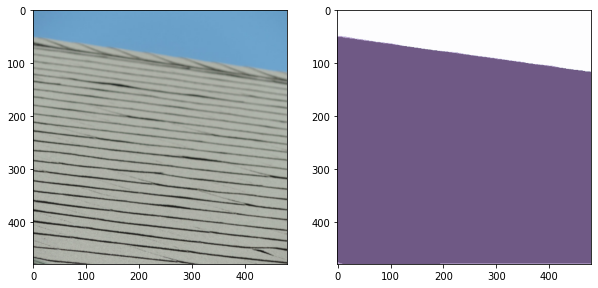

02B3664701_2015042/027.JPG


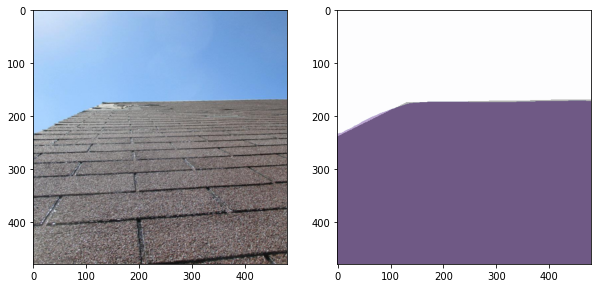

02B3383601_2015023/008.JPG


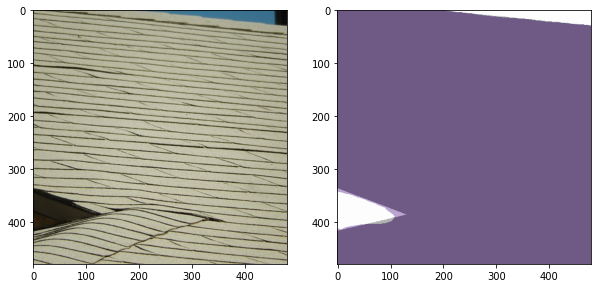

02B3579901_2015042/007.JPG


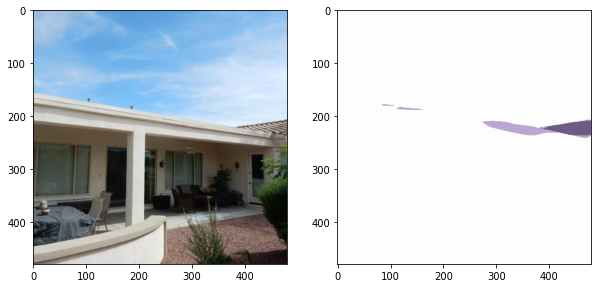

02B3320701_2015022/002.JPG


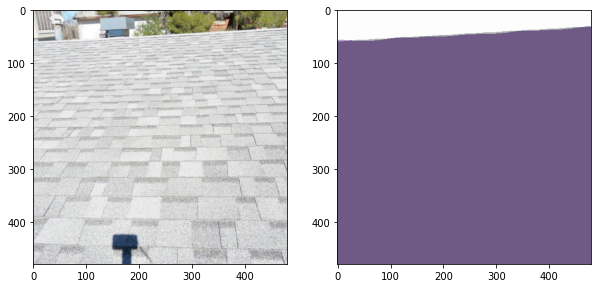

02B0106301_2015111/004.JPG


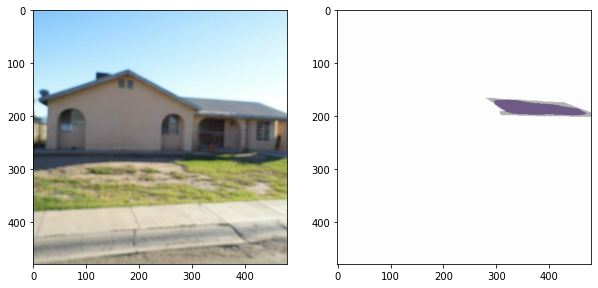

02B3205201_2015011/008.JPG


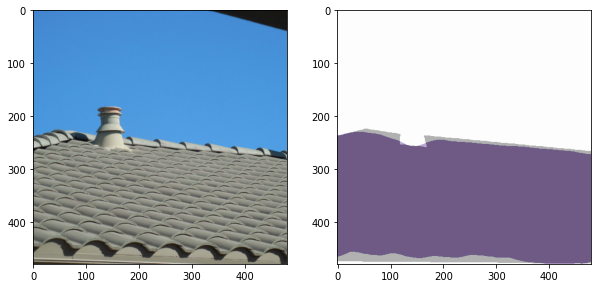

02B1353101_2015053/007.JPG


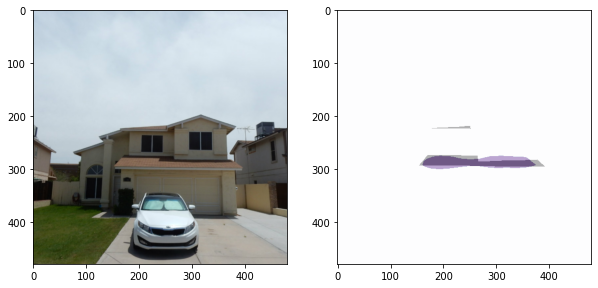

02B2710001_2017011/003.JPG


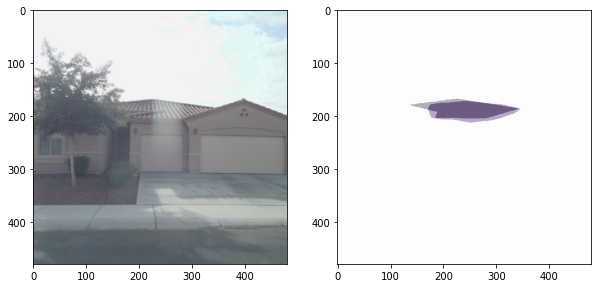

02B3279901_2016051/004.JPG


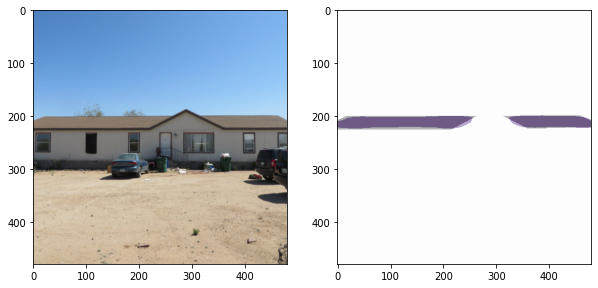

02B3405001_2015024/005.JPG


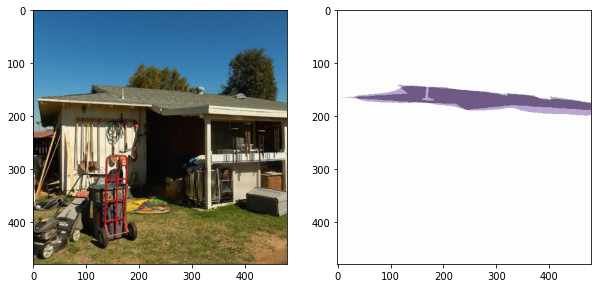

02B3836701_2015055/013.JPG


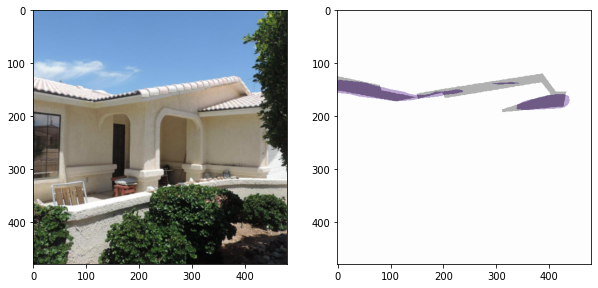

02B3507601_2015033/011.JPG


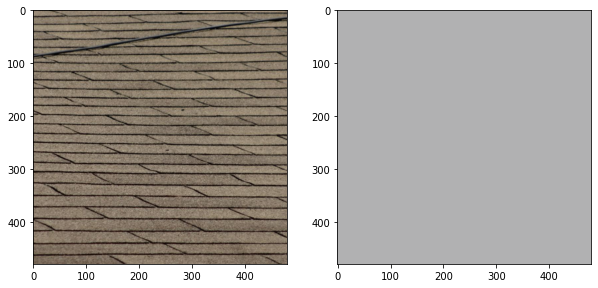

02B0230701_2015111/008.JPG


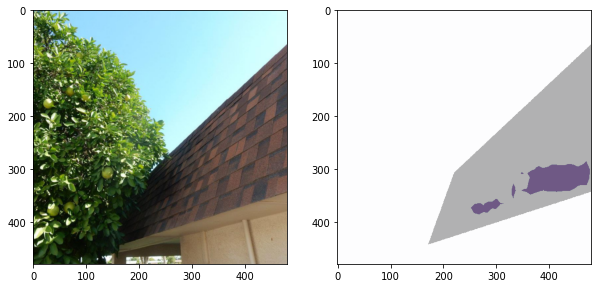

02B3558301_2015041/008.JPG


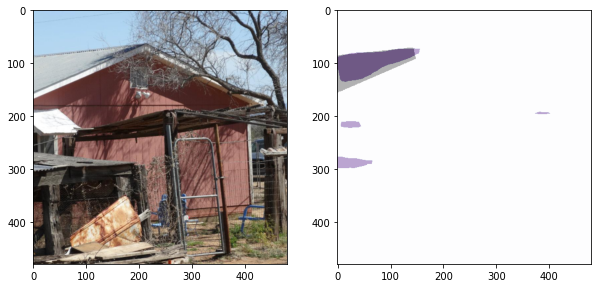

02B3346501_2015022/008.JPG


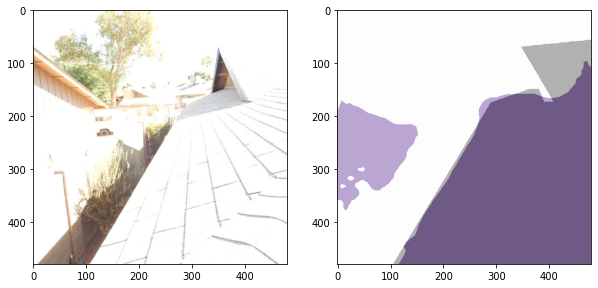

02B3498701_2015083/008.JPG


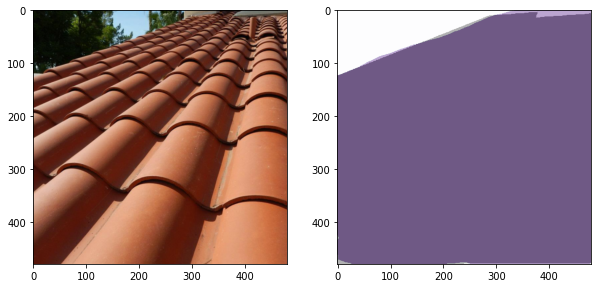

02B0503301_2016101/008.JPG


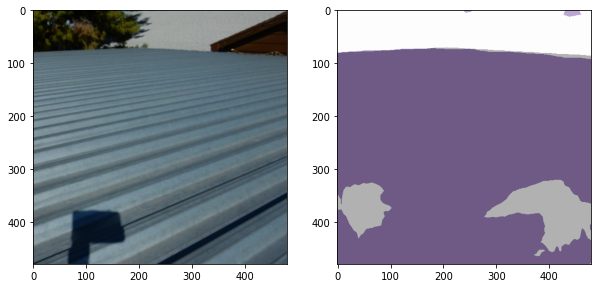

02B3357601_2015023/009.JPG


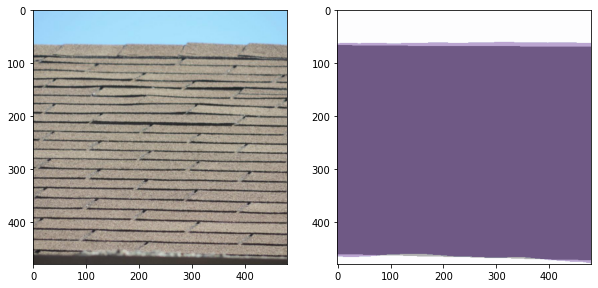

02B2329801_2015091/003.JPG


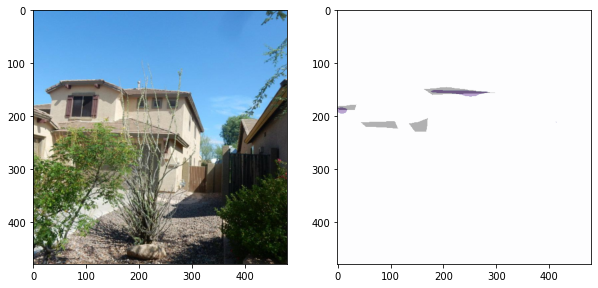

02B3836701_2015055/014.JPG


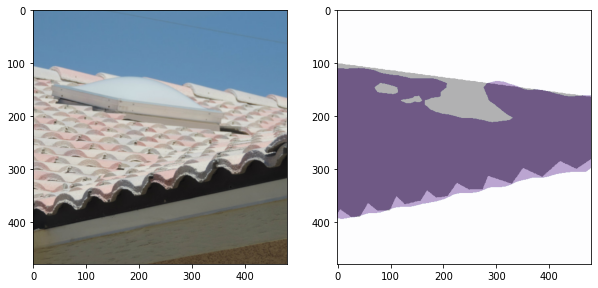

02B3221101_2015013/010.JPG


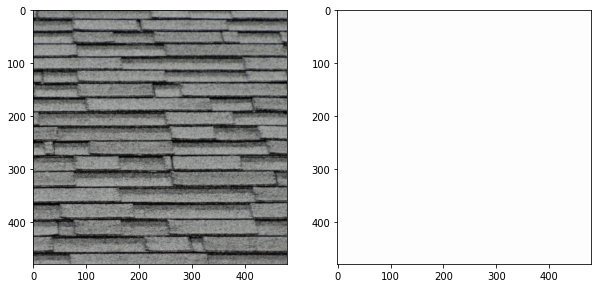

02B3564601_2015041/004.JPG


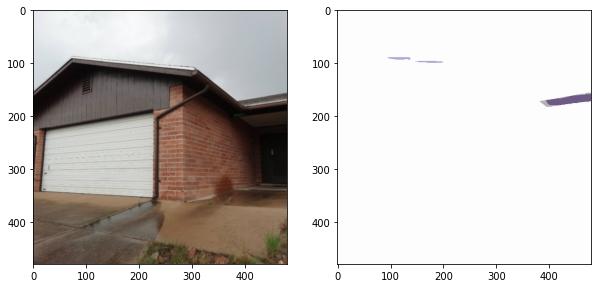

02B0833201_2015013/004.JPG


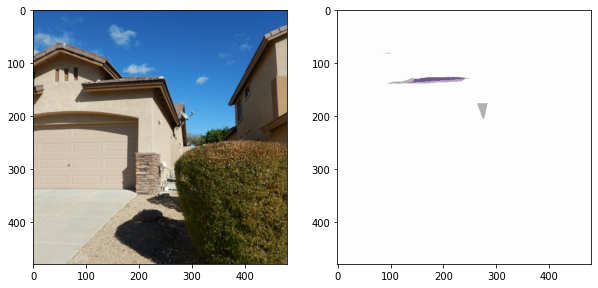

02B3517901_2017022/009.JPG


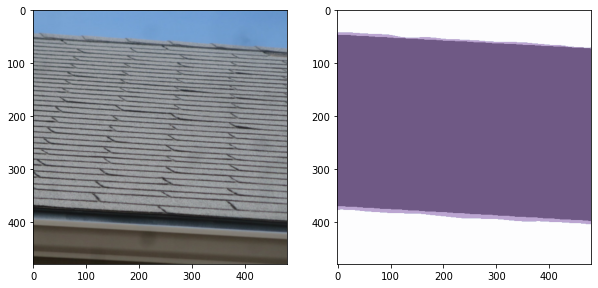

02B3695601_2015051/007.JPG


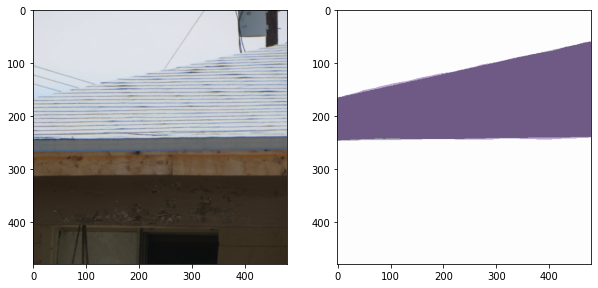

02B1760701_2016065/007.JPG


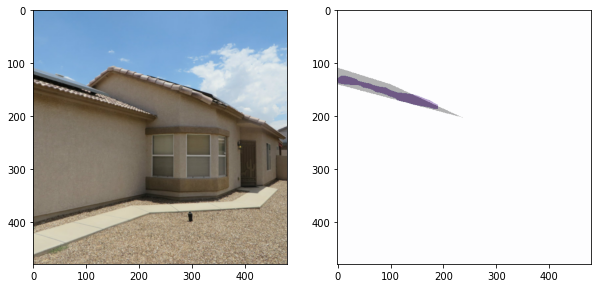

02B3561601_2017084/002.JPG


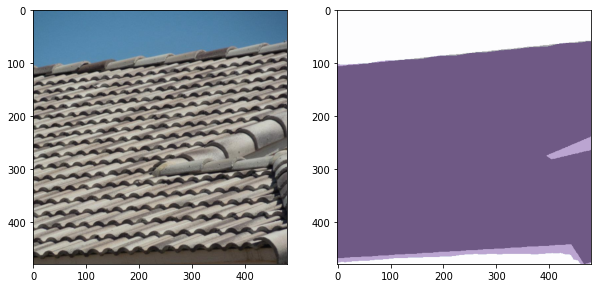

02B0107001_2016101/008.JPG


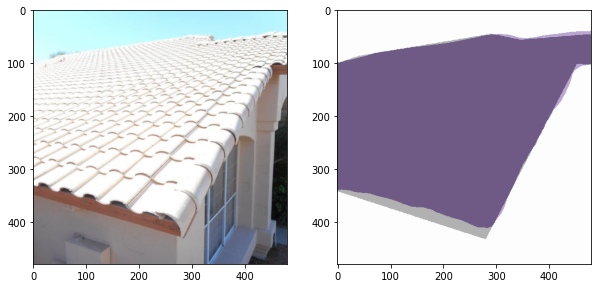

02B3762201_2015051/005.JPG


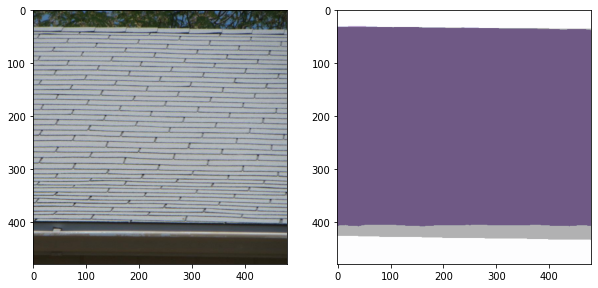

02B3396801_2015022/007.JPG


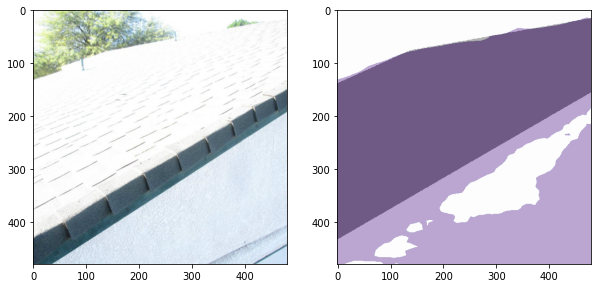

02B0187901_2015093/007.JPG


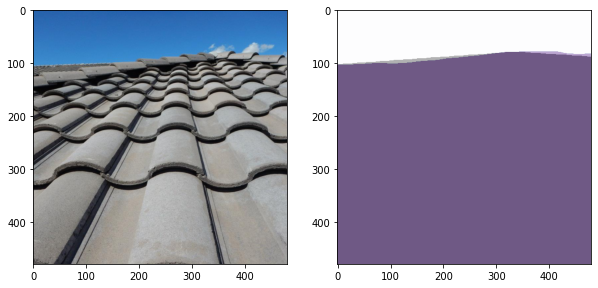

02B0504901_2016102/004.JPG


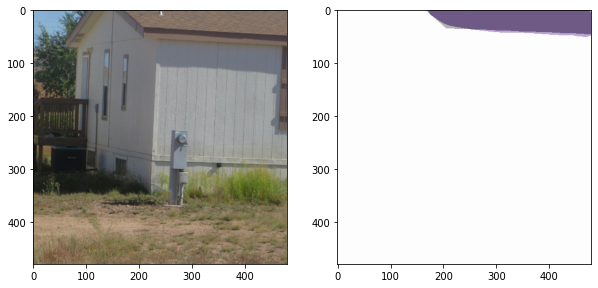

In [154]:
# 9645
model.load_state_dict(torch.load(checkpoint_path)['state_dict'])
for ind in range(200):
    print(data['ext_id_list_val'][ind])
    input_img,target = testset_img[ind]
    inputs = input_transform(input_img).unsqueeze(0)
    inputs = inputs.cuda()
    output = model.evaluate(inputs)
    predict = torch.max(output, 1)[1].cpu().numpy()
    #fig, axes = plt.subplots(nrows=1, ncols=2)
    fig, ax = plt.subplots(1,2, figsize=(10,5))
    ax[0].imshow(input_img)
    ax[1].imshow(predict[0], cmap = 'Purples', alpha=0.5)
    ax[1].imshow(target.numpy(), cmap='Greys', alpha=0.3)
    plt.show()
    #break

02B0002701_2015095/002.JPG


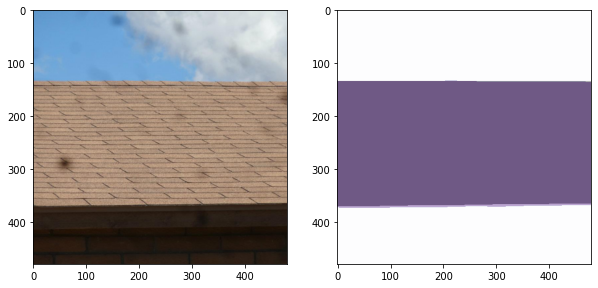

02B3614901_2015042/009.JPG


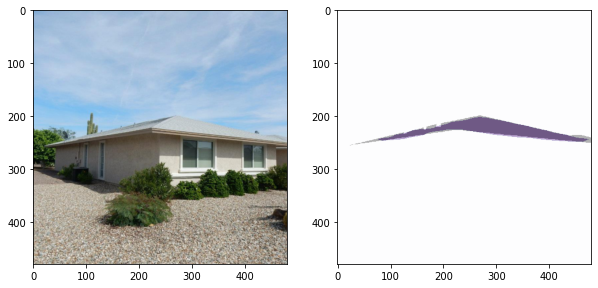

02B3204601_2015013/004.JPG


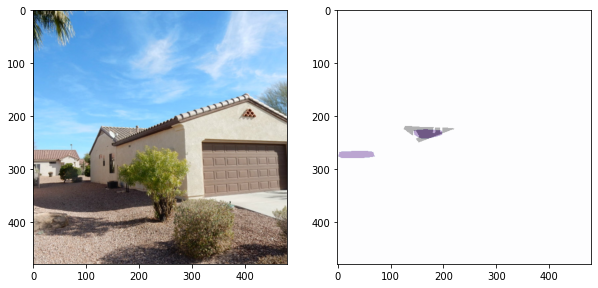

02B3885101_2015061/002.JPG


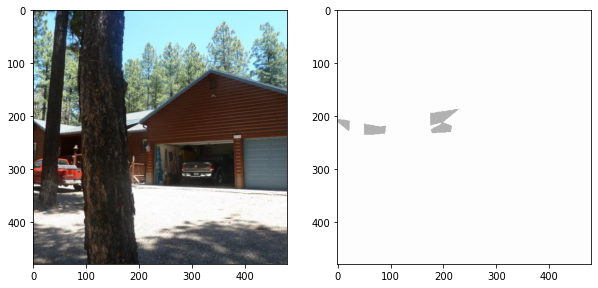

02B3622701_2015042/003.JPG


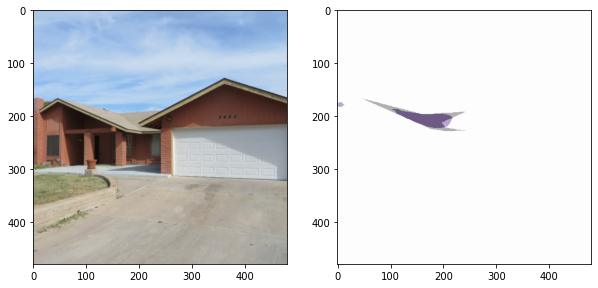

02B3740201_2015051/006.JPG


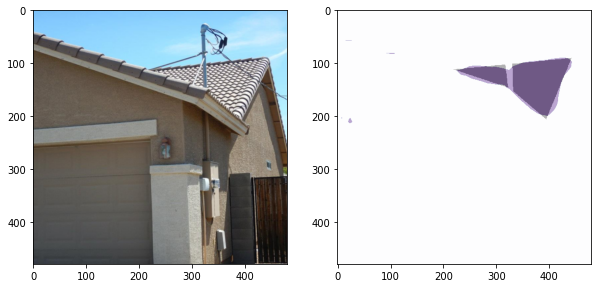

02B3189501_2015011/007.JPG


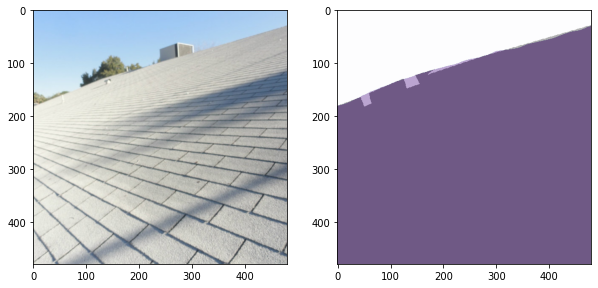

02B4080901_2015071/013.JPG


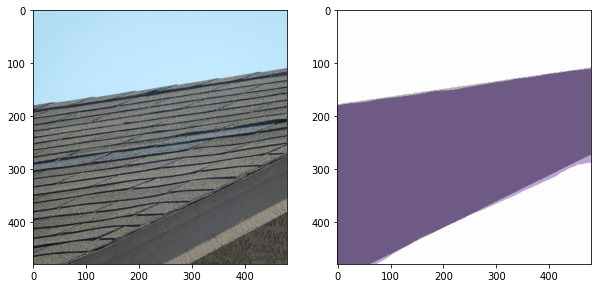

02B3384901_2015023/008.JPG


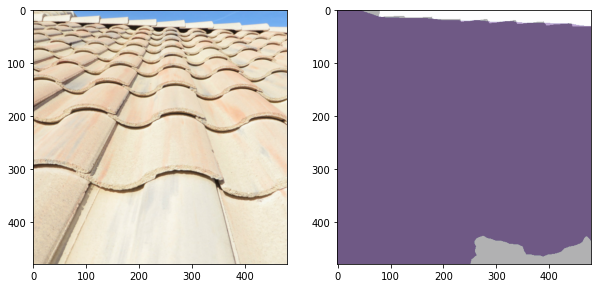

02B0106301_2015111/009.JPG


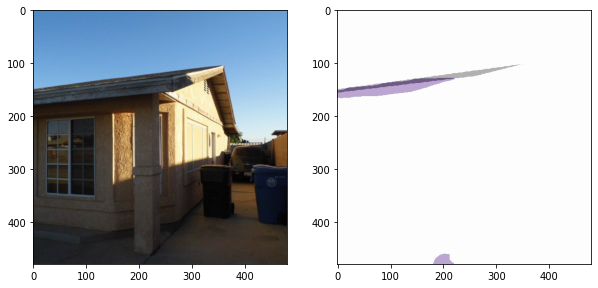

02B3743901_2015101/003.JPG


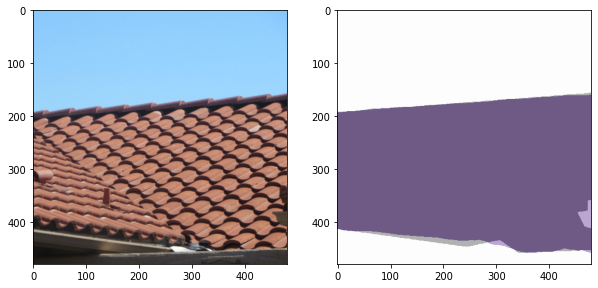

02B3384901_2015023/008.JPG


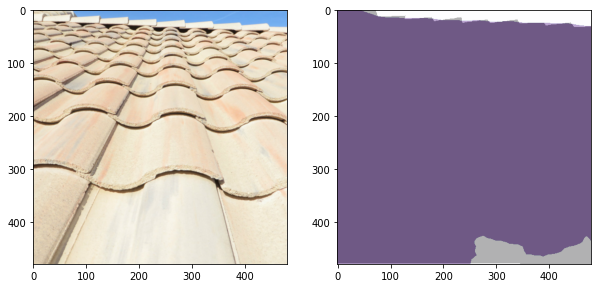

02B1197001_2015041/012.JPG


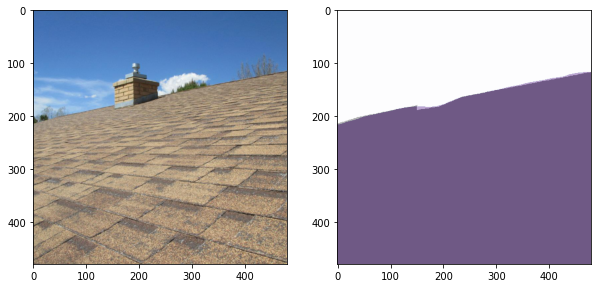

02B3740201_2015051/004.JPG


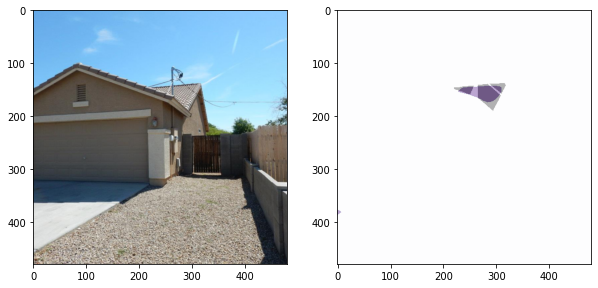

02B1224001_2017015/005.JPG


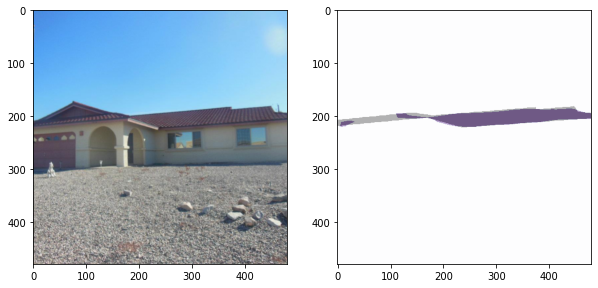

02B4039201_2015062/002.JPG


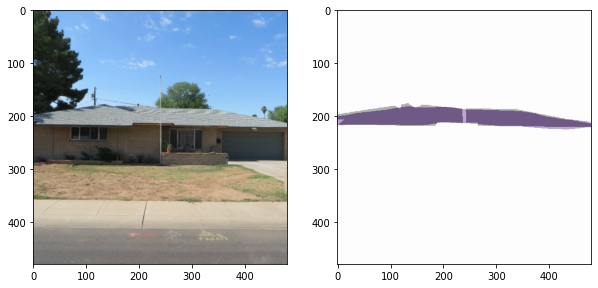

02B3728901_2015051/011.JPG


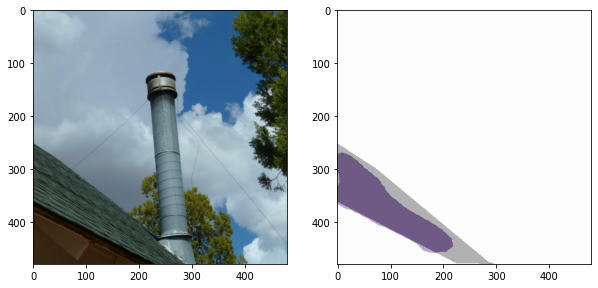

02B3937201_2015061/010.JPG


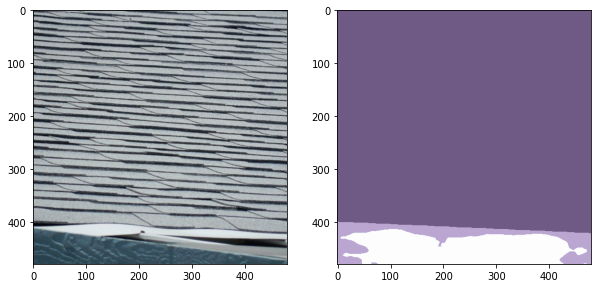

02B3478701_2015031/012.JPG


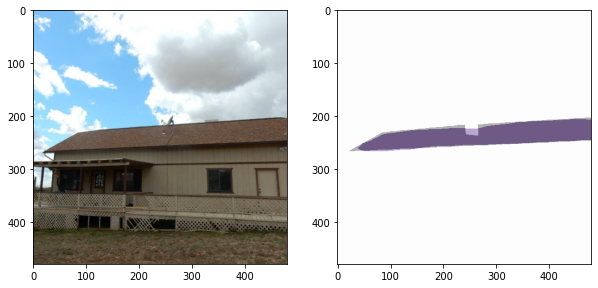

02B3739001_2015051/003.JPG


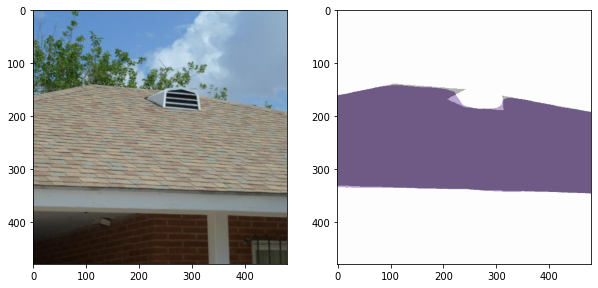

In [152]:
# 9303
for ind in range(20):
    print(data['ext_id_list_val'][ind])
    input_img,target = testset_img[ind]
    inputs = input_transform(input_img).unsqueeze(0)
    inputs = inputs.cuda()
    output = model.evaluate(inputs)
    predict = torch.max(output, 1)[1].cpu().numpy()
    #fig, axes = plt.subplots(nrows=1, ncols=2)
    fig, ax = plt.subplots(1,2, figsize=(10,5))
    ax[0].imshow(input_img)
    ax[1].imshow(predict[0], cmap = 'Purples', alpha=0.5)
    ax[1].imshow(target.numpy(), cmap='Greys', alpha=0.3)
    plt.show()
    #break

## test on MLS-10k

In [155]:
path_to_mls10k = '/home/ubuntu/RoofData/mls-10k/'

In [157]:
images_mls10k = os.listdir(path_to_mls10k)

In [ ]:
# 9645
#model.load_state_dict(torch.load(checkpoint_path)['state_dict'])
for ind in range(2):
    path_to_img = os.path.join(path_to_mls10k, images_mls10k[ind])
    print(path_to_img)
    img = Image.open(os.path.join(self.root,'images',self.images[index])).convert('RGB')

    
    input_img,target = testset_img[ind]
    inputs = input_transform(input_img).unsqueeze(0)
    inputs = inputs.cuda()
    output = model.evaluate(inputs)
    predict = torch.max(output, 1)[1].cpu().numpy()
    #fig, axes = plt.subplots(nrows=1, ncols=2)
    fig, ax = plt.subplots(1,2, figsize=(10,5))
    ax[0].imshow(input_img)
    ax[1].imshow(predict[0], cmap = 'Purples', alpha=0.5)
    ax[1].imshow(target.numpy(), cmap='Greys', alpha=0.3)
    plt.show()
    #break